# Educational Process Mining

https://archive-beta.ics.uci.edu/dataset/346/educational+process+mining+epm+a+learning+analytics+data+set

Educational Process Mining (EPM): A Learning Analytics Data Set. (2015). UCI Machine Learning Repository.

## Poisson Regression to model final questions
The final exam consisted of 16 questions where each question focused on content from a specific session. Each session has two or more related questions follows: 
* Session 1: two questions
* Session 2: two questions
* Session 3: five questions
* Session 4: two questions
* Session 5: three questions
* Session 6: two questions

The questions correspond to trials, and the number of questions answered correctly correspond to events. Student participation (input data) was recorded by activity, exercise, and session. The number of trials and events for each student and session are counts, which can be modeled using Poisson or Negative Binomial Regression. This notebook uses both Poisson and Negative Binomial Regression to model the number of expected correctly answered final questions.

The original values and principle components were used with both Poisson and Negative Binomial Regression methods. Using the AIC as the performance metric, the best model from all four methods was the purely additive model with categorical features `sid` and `actv_grp` and numeric features, either the interpolated variables or the principle components:  </br> 
`final_events ~ sid + actv_grp + numeric_features`

The fact that the student ID, activity group, and numeric features were important indicates that both the student and the student's behavior as measured by mouse and keyboard activity are required to determine the outcome.

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

import seaborn as sns

In [2]:
import statsmodels.formula.api as smf
import statsmodels.api as sm

In [3]:
from patsy import dmatrices

from sklearn.preprocessing import StandardScaler

from sklearn.decomposition import PCA

## Include functions
CMPINF2120_EPM_FUNC_INCL_Over_Lisa.ipynb includes functions used in this notebook.

In [4]:
%run CMPINF2120_EPM_FUNC_INCL_Over_Lisa.ipynb

## Load the data from github repository

In [5]:
inputs_final_sqrt_path = 'https://raw.githubusercontent.com/lisaover/CMPINF2120_project/main/tp_sqrt_inputs_final_df.csv'
final_path = 'https://raw.githubusercontent.com/lisaover/CMPINF2120_project/main/final_df.csv'
pts_path = 'https://raw.githubusercontent.com/lisaover/CMPINF2120_project/main/final_points_lookup.csv'

In [6]:
final_sqrt_init = pd.read_csv(inputs_final_sqrt_path)
final_init = pd.read_csv(final_path)
pts_final_lookup = pd.read_csv(pts_path)

In [7]:
final_sqrt_init.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2444 entries, 0 to 2443
Data columns (total 82 columns):
 #   Column               Non-Null Count  Dtype  
---  ------               --------------  -----  
 0   sess                 2444 non-null   int64  
 1   sid                  2444 non-null   int64  
 2   actv_grp             2444 non-null   object 
 3   total_ms_tp000_sqrt  2444 non-null   float64
 4   mw_tp000_sqrt        2444 non-null   float64
 5   mwc_tp000_sqrt       2444 non-null   float64
 6   mcl_tp000_sqrt       2444 non-null   float64
 7   mcr_tp000_sqrt       2444 non-null   float64
 8   mm_tp000_sqrt        2444 non-null   float64
 9   ks_tp000_sqrt        2444 non-null   float64
 10  total_ms_tp010_sqrt  2444 non-null   float64
 11  mw_tp010_sqrt        2444 non-null   float64
 12  mwc_tp010_sqrt       2444 non-null   float64
 13  mcl_tp010_sqrt       2444 non-null   float64
 14  mcr_tp010_sqrt       2444 non-null   float64
 15  mm_tp010_sqrt        2444 non-null   f

In [8]:
final_sqrt_init.isna().sum()

sess                   0
sid                    0
actv_grp               0
total_ms_tp000_sqrt    0
mw_tp000_sqrt          0
                      ..
mcr_tp100_sqrt         0
mm_tp100_sqrt          0
ks_tp100_sqrt          0
final_events           0
final_trials           0
Length: 82, dtype: int64

#### Prepare final data for count visualization

In [9]:
final_init.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 62 entries, 0 to 61
Data columns (total 18 columns):
 #   Column       Non-Null Count  Dtype  
---  ------       --------------  -----  
 0   sid          62 non-null     int64  
 1   Es_1q1       62 non-null     float64
 2   Es_1q2       62 non-null     float64
 3   Es_2q1       62 non-null     float64
 4   Es_2q2       62 non-null     float64
 5   Es_3q1       62 non-null     float64
 6   Es_3q2       62 non-null     float64
 7   Es_3q3       62 non-null     float64
 8   Es_3q4       62 non-null     float64
 9   Es_3q5       62 non-null     float64
 10  Es_4q1       62 non-null     float64
 11  Es_4q2       62 non-null     float64
 12  Es_5q1       62 non-null     float64
 13  Es_5q2       62 non-null     float64
 14  Es_5q3       62 non-null     float64
 15  Es_6q1       62 non-null     float64
 16  Es_6q2       62 non-null     float64
 17  final_score  62 non-null     float64
dtypes: float64(17), int64(1)
memory usage: 8.8 KB


In [10]:
final_init.isna().sum()

sid            0
Es_1q1         0
Es_1q2         0
Es_2q1         0
Es_2q2         0
Es_3q1         0
Es_3q2         0
Es_3q3         0
Es_3q4         0
Es_3q5         0
Es_4q1         0
Es_4q2         0
Es_5q1         0
Es_5q2         0
Es_5q3         0
Es_6q1         0
Es_6q2         0
final_score    0
dtype: int64

In [11]:
pts_final_lookup.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 17 entries, 0 to 16
Data columns (total 2 columns):
 #   Column           Non-Null Count  Dtype 
---  ------           --------------  ----- 
 0   question         17 non-null     object
 1   question_points  17 non-null     int64 
dtypes: int64(1), object(1)
memory usage: 400.0+ bytes


In [12]:
pts_final_lookup.isna().sum()

question           0
question_points    0
dtype: int64

Melt final_init and create a session variable

In [13]:
final_lf = final_init.melt( id_vars=['sid']).\
             rename(columns={"variable": "question", "value": "quest_scr"}).\
             copy()

In [14]:
final_lf['sess'] = final_lf.question.str.extract('(\d)')

Merge final_lf with pts_init and create a pass/fail variable for each student and question

In [15]:
final_lf_b = pd.merge(final_lf, pts_final_lookup, on='question', how='left')

In [16]:
final_lf_b.head()

,sid,question,quest_scr,sess,question_points
0,1,Es_1q1,2.0,1,2
1,2,Es_1q1,2.0,1,2
2,4,Es_1q1,2.0,1,2
3,5,Es_1q1,2.0,1,2
4,7,Es_1q1,2.0,1,2


In [17]:
final_lf_b['Qpass'] = [1 if i/j >= 0.7 else 0 for (i, j) in zip(final_lf_b['quest_scr'],final_lf_b['question_points'])]

In [18]:
final_lf_b.head()

,sid,question,quest_scr,sess,question_points,Qpass
0,1,Es_1q1,2.0,1,2,1
1,2,Es_1q1,2.0,1,2,1
2,4,Es_1q1,2.0,1,2,1
3,5,Es_1q1,2.0,1,2,1
4,7,Es_1q1,2.0,1,2,1


#### Prepare input/final data for modeling

In [19]:
final_sqrt_init['sid'] = final_sqrt_init['sid'].astype('object')
final_sqrt_init['sess'] = final_sqrt_init['sess'].astype('object')

In [20]:
final_sqrt_df = final_sqrt_init.copy()

In [21]:
sqrt_vars = get_var_list(final_sqrt_df,['sqrt'])

In [22]:
sqrt_features_df = final_sqrt_df.loc[:, sqrt_vars].copy()

In [23]:
sqrt_features_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2444 entries, 0 to 2443
Data columns (total 77 columns):
 #   Column               Non-Null Count  Dtype  
---  ------               --------------  -----  
 0   total_ms_tp000_sqrt  2444 non-null   float64
 1   mw_tp000_sqrt        2444 non-null   float64
 2   mwc_tp000_sqrt       2444 non-null   float64
 3   mcl_tp000_sqrt       2444 non-null   float64
 4   mcr_tp000_sqrt       2444 non-null   float64
 5   mm_tp000_sqrt        2444 non-null   float64
 6   ks_tp000_sqrt        2444 non-null   float64
 7   total_ms_tp010_sqrt  2444 non-null   float64
 8   mw_tp010_sqrt        2444 non-null   float64
 9   mwc_tp010_sqrt       2444 non-null   float64
 10  mcl_tp010_sqrt       2444 non-null   float64
 11  mcr_tp010_sqrt       2444 non-null   float64
 12  mm_tp010_sqrt        2444 non-null   float64
 13  ks_tp010_sqrt        2444 non-null   float64
 14  total_ms_tp020_sqrt  2444 non-null   float64
 15  mw_tp020_sqrt        2444 non-null   f

In [24]:
sqrt_feature_names = sqrt_features_df.columns

In [25]:
len(sqrt_feature_names)

77

## Visualizations

In [26]:
final_sqrt_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2444 entries, 0 to 2443
Data columns (total 82 columns):
 #   Column               Non-Null Count  Dtype  
---  ------               --------------  -----  
 0   sess                 2444 non-null   object 
 1   sid                  2444 non-null   object 
 2   actv_grp             2444 non-null   object 
 3   total_ms_tp000_sqrt  2444 non-null   float64
 4   mw_tp000_sqrt        2444 non-null   float64
 5   mwc_tp000_sqrt       2444 non-null   float64
 6   mcl_tp000_sqrt       2444 non-null   float64
 7   mcr_tp000_sqrt       2444 non-null   float64
 8   mm_tp000_sqrt        2444 non-null   float64
 9   ks_tp000_sqrt        2444 non-null   float64
 10  total_ms_tp010_sqrt  2444 non-null   float64
 11  mw_tp010_sqrt        2444 non-null   float64
 12  mwc_tp010_sqrt       2444 non-null   float64
 13  mcl_tp010_sqrt       2444 non-null   float64
 14  mcr_tp010_sqrt       2444 non-null   float64
 15  mm_tp010_sqrt        2444 non-null   f

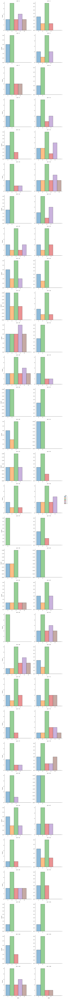

In [27]:
sns.displot( data = final_lf_b.loc[final_lf_b.Qpass==1], x='sess', col='sid', col_wrap=2, 
            hue='sess', kind='hist', binwidth = 1, facet_kws={'sharey':False, 'sharex':False})

plt.show()

##### Output to input relationships via scatter plots

In [28]:
final_sqrt_lf = final_sqrt_df.melt(id_vars=['sess','sid','actv_grp','final_events','final_trials'], ignore_index=True).copy()

In [29]:
final_sqrt_lf.head()

,sess,sid,actv_grp,final_events,final_trials,variable,value
0,1,1,Aulaweb,2.0,2.0,total_ms_tp000_sqrt,89.442719
1,1,1,Blank,2.0,2.0,total_ms_tp000_sqrt,89.442719
2,1,1,Deeds,2.0,2.0,total_ms_tp000_sqrt,202.484567
3,1,1,Diagram,2.0,2.0,total_ms_tp000_sqrt,939.148551
4,1,1,Other,2.0,2.0,total_ms_tp000_sqrt,31.622777


In [30]:
final_sqrt_lf.actv_grp.unique()

array(['Aulaweb', 'Blank', 'Deeds', 'Diagram', 'Other', 'Properties',
       'Study', 'TextEditor', 'Study_Materials', 'FSM_Related', 'FSM'],
      dtype=object)

In [31]:
actv_subgrp_1 = ['Aulaweb','Deeds','Diagram','TextEditor','FSM_Related','FSM']

In [32]:
actv_subgrp_2 = ['Blank','Other','Properties','Study','Study_Materials']

In [33]:
sns.relplot( data = final_sqrt_lf.loc[final_sqrt_lf.actv_grp.isin(actv_subgrp_1) & (final_sqrt_lf['sess']==1)], 
            x='final_events', y='value', 
            col='actv_grp', row='variable', hue='actv_grp',
            facet_kws={'sharey': False, 'sharex': False})

plt.show()

In [34]:
sns.relplot( data = final_sqrt_lf.loc[final_sqrt_lf.actv_grp.isin(actv_subgrp_1) & (final_sqrt_lf['sess']==2)], 
            x='final_events', y='value', 
            col='actv_grp', row='variable', hue='actv_grp',
            facet_kws={'sharey': False, 'sharex': False})

plt.show()

In [35]:
sns.relplot( data = final_sqrt_lf.loc[final_sqrt_lf.actv_grp.isin(actv_subgrp_1) & (final_sqrt_lf['sess']==3)], 
            x='final_events', y='value', 
            col='actv_grp', row='variable', hue='actv_grp',
            facet_kws={'sharey': False, 'sharex': False})

plt.show()

In [36]:
sns.relplot( data = final_sqrt_lf.loc[final_sqrt_lf.actv_grp.isin(actv_subgrp_1) & (final_sqrt_lf['sess']==4)], 
            x='final_events', y='value', 
            col='actv_grp', row='variable', hue='actv_grp',
            facet_kws={'sharey': False, 'sharex': False})

plt.show()

In [37]:
sns.relplot( data = final_sqrt_lf.loc[final_sqrt_lf.actv_grp.isin(actv_subgrp_1) & (final_sqrt_lf['sess']==5)], 
            x='final_events', y='value', 
            col='actv_grp', row='variable', hue='actv_grp',
            facet_kws={'sharey': False, 'sharex': False})

plt.show()

In [38]:
sns.relplot( data = final_sqrt_lf.loc[final_sqrt_lf.actv_grp.isin(actv_subgrp_1) & (final_sqrt_lf['sess']==6)], 
            x='final_events', y='value', 
            col='actv_grp', row='variable', hue='actv_grp',
            facet_kws={'sharey': False, 'sharex': False})

plt.show()

In [39]:
final_sqrt_df.columns

Index(['sess', 'sid', 'actv_grp', 'total_ms_tp000_sqrt', 'mw_tp000_sqrt',
       'mwc_tp000_sqrt', 'mcl_tp000_sqrt', 'mcr_tp000_sqrt', 'mm_tp000_sqrt',
       'ks_tp000_sqrt', 'total_ms_tp010_sqrt', 'mw_tp010_sqrt',
       'mwc_tp010_sqrt', 'mcl_tp010_sqrt', 'mcr_tp010_sqrt', 'mm_tp010_sqrt',
       'ks_tp010_sqrt', 'total_ms_tp020_sqrt', 'mw_tp020_sqrt',
       'mwc_tp020_sqrt', 'mcl_tp020_sqrt', 'mcr_tp020_sqrt', 'mm_tp020_sqrt',
       'ks_tp020_sqrt', 'total_ms_tp030_sqrt', 'mw_tp030_sqrt',
       'mwc_tp030_sqrt', 'mcl_tp030_sqrt', 'mcr_tp030_sqrt', 'mm_tp030_sqrt',
       'ks_tp030_sqrt', 'total_ms_tp040_sqrt', 'mw_tp040_sqrt',
       'mwc_tp040_sqrt', 'mcl_tp040_sqrt', 'mcr_tp040_sqrt', 'mm_tp040_sqrt',
       'ks_tp040_sqrt', 'total_ms_tp050_sqrt', 'mw_tp050_sqrt',
       'mwc_tp050_sqrt', 'mcl_tp050_sqrt', 'mcr_tp050_sqrt', 'mm_tp050_sqrt',
       'ks_tp050_sqrt', 'total_ms_tp060_sqrt', 'mw_tp060_sqrt',
       'mwc_tp060_sqrt', 'mcl_tp060_sqrt', 'mcr_tp060_sqrt', 'mm_tp060_sqr

In [40]:
totl_vars = get_var_list_b(final_sqrt_df,['total'])
mw_vars = get_var_list_b(final_sqrt_df,['mw_'])
mwc_vars = get_var_list_b(final_sqrt_df,['mwc'])
mcl_vars = get_var_list_b(final_sqrt_df,['mcl'])
mcr_vars = get_var_list_b(final_sqrt_df,['mcr'])
mm_vars = get_var_list_b(final_sqrt_df,['mm'])
ks_vars = get_var_list_b(final_sqrt_df,['mws'])

##### Bar chart shows the inputs have different scales

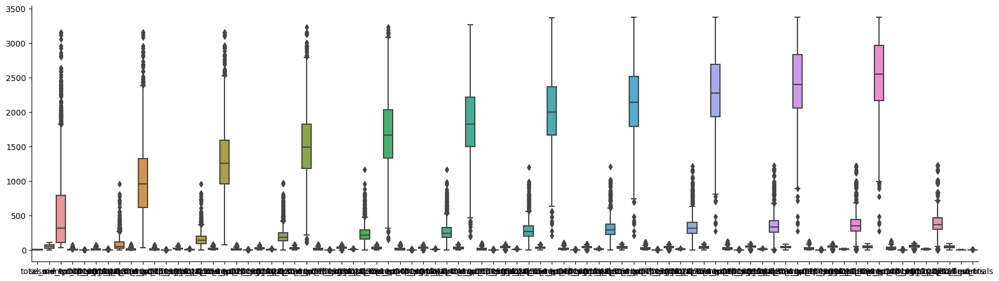

In [41]:
sns.catplot(data = final_sqrt_df, kind='box', aspect=3.5)

plt.show()

##### Correlation plot shows the inputs are highly correlated

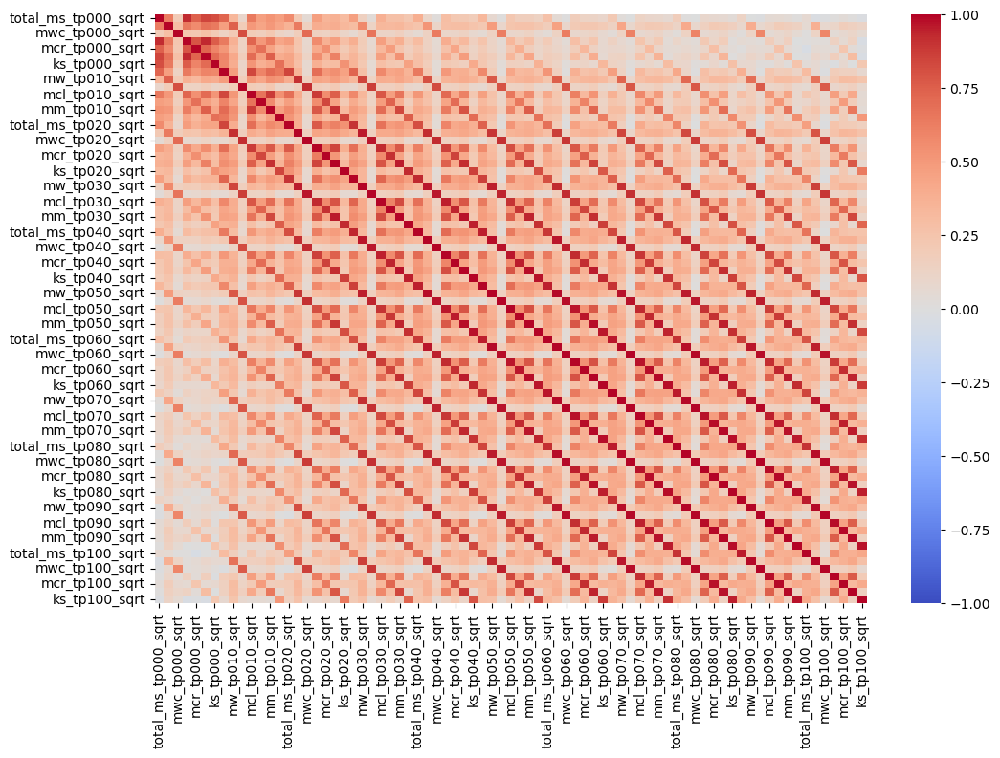

In [42]:
fig, ax = plt.subplots(figsize=(12, 8))

sns.heatmap(data = final_sqrt_df[sqrt_feature_names].corr(), 
            vmin=-1, vmax=1, center = 0,
            cmap='coolwarm', 
            ax=ax)

plt.show()

## Standardize the numeric inputs

In [43]:
Xtimepoints = StandardScaler().fit_transform( sqrt_features_df )

In [44]:
Xtimepoints.shape

(2444, 77)

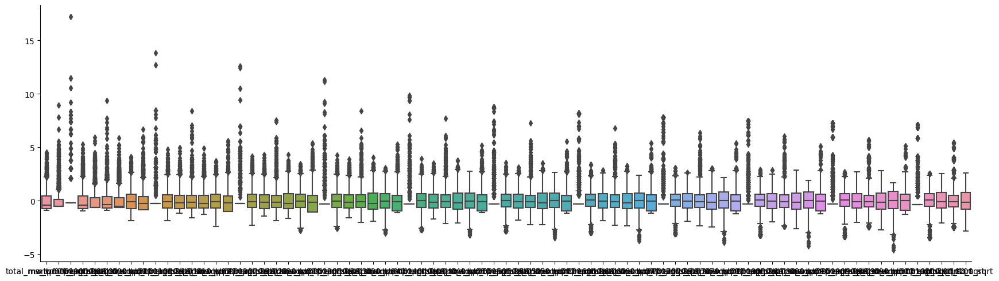

In [45]:
sns.catplot(data = pd.DataFrame(Xtimepoints, columns=sqrt_feature_names), kind='box', aspect=3.5)

plt.show()

## Poisson Regression with standardized features

In [46]:
final_sqrt_std_df = pd.concat([final_sqrt_df.loc[:,['sess','sid','actv_grp','final_events','final_trials']].copy(), pd.DataFrame(Xtimepoints, columns=sqrt_feature_names).copy()], axis=1)

In [47]:
final_sqrt_std_df.head()

,sess,sid,actv_grp,final_events,final_trials,total_ms_tp000_sqrt,mw_tp000_sqrt,mwc_tp000_sqrt,mcl_tp000_sqrt,mcr_tp000_sqrt,...,mcr_tp090_sqrt,mm_tp090_sqrt,ks_tp090_sqrt,total_ms_tp100_sqrt,mw_tp100_sqrt,mwc_tp100_sqrt,mcl_tp100_sqrt,mcr_tp100_sqrt,mm_tp100_sqrt,ks_tp100_sqrt
0,1,1,Aulaweb,2.0,2.0,-0.790076,-0.521312,-0.182566,-0.764020,-0.612717,...,1.005451,0.955513,-0.736663,0.045447,-0.222258,-0.340979,0.889260,1.185153,1.194975,-0.717268
1,1,1,Blank,2.0,2.0,-0.790076,-0.521312,-0.182566,-0.764020,-0.612717,...,1.027941,0.992772,-0.733079,0.042272,-0.224584,-0.340979,0.885189,1.185153,1.191882,-0.717268
2,1,1,Deeds,2.0,2.0,-0.594451,-0.214631,-0.182566,-0.638176,-0.612717,...,1.007958,0.969835,-0.737460,-0.099400,-0.248136,-0.340979,0.763366,1.129168,1.095563,-0.783181
3,1,1,Diagram,2.0,2.0,0.680382,0.175782,-0.182566,0.907550,1.709392,...,0.997917,0.924780,-0.755483,0.010015,-0.248136,-0.340979,0.845303,1.174033,1.161415,-0.783181
4,1,1,Other,2.0,2.0,-0.890136,-0.521312,-0.182566,-0.935924,-0.612717,...,1.027941,1.034190,-0.721576,0.042272,-0.224584,-0.340979,0.884171,1.185153,1.191564,-0.717268


In [48]:
num_features_str = ''
for ix, x in enumerate(sqrt_feature_names):
    if ix == len(sqrt_feature_names) - 1:
        num_features_str = num_features_str + x
    else:
        num_features_str = num_features_str + x + ' + '
num_features_str

'total_ms_tp000_sqrt + mw_tp000_sqrt + mwc_tp000_sqrt + mcl_tp000_sqrt + mcr_tp000_sqrt + mm_tp000_sqrt + ks_tp000_sqrt + total_ms_tp010_sqrt + mw_tp010_sqrt + mwc_tp010_sqrt + mcl_tp010_sqrt + mcr_tp010_sqrt + mm_tp010_sqrt + ks_tp010_sqrt + total_ms_tp020_sqrt + mw_tp020_sqrt + mwc_tp020_sqrt + mcl_tp020_sqrt + mcr_tp020_sqrt + mm_tp020_sqrt + ks_tp020_sqrt + total_ms_tp030_sqrt + mw_tp030_sqrt + mwc_tp030_sqrt + mcl_tp030_sqrt + mcr_tp030_sqrt + mm_tp030_sqrt + ks_tp030_sqrt + total_ms_tp040_sqrt + mw_tp040_sqrt + mwc_tp040_sqrt + mcl_tp040_sqrt + mcr_tp040_sqrt + mm_tp040_sqrt + ks_tp040_sqrt + total_ms_tp050_sqrt + mw_tp050_sqrt + mwc_tp050_sqrt + mcl_tp050_sqrt + mcr_tp050_sqrt + mm_tp050_sqrt + ks_tp050_sqrt + total_ms_tp060_sqrt + mw_tp060_sqrt + mwc_tp060_sqrt + mcl_tp060_sqrt + mcr_tp060_sqrt + mm_tp060_sqrt + ks_tp060_sqrt + total_ms_tp070_sqrt + mw_tp070_sqrt + mwc_tp070_sqrt + mcl_tp070_sqrt + mcr_tp070_sqrt + mm_tp070_sqrt + ks_tp070_sqrt + total_ms_tp080_sqrt + mw_tp080_

In [49]:
descriptive_formulas = ['final_events ~ sid'
                        ,'final_events ~ sid + actv_grp'
                        ,'final_events ~ sid + actv_grp + ' + num_features_str
                        ,'final_events ~ sid * (' + num_features_str + ')'
                        ,'final_events ~ sid * (actv_grp + ' + num_features_str + ')'
                       ]

In [50]:
predictive_formulas = ['final_events ~ ' + num_features_str
                    ,'final_events ~ (' + num_features_str + ')**2'
                    ,'final_events ~ actv_grp + ' + num_features_str
                    ,'final_events ~ actv_grp * (' + num_features_str + ')'
                    ,'final_events ~ actv_grp + (' + num_features_str + ')**2'
                    ,'final_events ~ actv_grp * (' + num_features_str + ')**2'
                   ]

In [51]:
test_formula_list = descriptive_formulas + predictive_formulas

In [52]:
test_formula_list

['final_events ~ sid',
 'final_events ~ sid + actv_grp',
 'final_events ~ sid + actv_grp + total_ms_tp000_sqrt + mw_tp000_sqrt + mwc_tp000_sqrt + mcl_tp000_sqrt + mcr_tp000_sqrt + mm_tp000_sqrt + ks_tp000_sqrt + total_ms_tp010_sqrt + mw_tp010_sqrt + mwc_tp010_sqrt + mcl_tp010_sqrt + mcr_tp010_sqrt + mm_tp010_sqrt + ks_tp010_sqrt + total_ms_tp020_sqrt + mw_tp020_sqrt + mwc_tp020_sqrt + mcl_tp020_sqrt + mcr_tp020_sqrt + mm_tp020_sqrt + ks_tp020_sqrt + total_ms_tp030_sqrt + mw_tp030_sqrt + mwc_tp030_sqrt + mcl_tp030_sqrt + mcr_tp030_sqrt + mm_tp030_sqrt + ks_tp030_sqrt + total_ms_tp040_sqrt + mw_tp040_sqrt + mwc_tp040_sqrt + mcl_tp040_sqrt + mcr_tp040_sqrt + mm_tp040_sqrt + ks_tp040_sqrt + total_ms_tp050_sqrt + mw_tp050_sqrt + mwc_tp050_sqrt + mcl_tp050_sqrt + mcr_tp050_sqrt + mm_tp050_sqrt + ks_tp050_sqrt + total_ms_tp060_sqrt + mw_tp060_sqrt + mwc_tp060_sqrt + mcl_tp060_sqrt + mcr_tp060_sqrt + mm_tp060_sqrt + ks_tp060_sqrt + total_ms_tp070_sqrt + mw_tp070_sqrt + mwc_tp070_sqrt + mcl_tp0

##### Evaluate number of features with dmatrices

In [53]:
sk_list = make_dmat(final_sqrt_std_df, test_formula_list)

In [54]:
model_dim = make_dim_df(final_sqrt_std_df, sk_list, test_formula_list)

In [55]:
model_dim

,model name,dimensions,number of obs,dim < obs
0,0,62,2444,Yes
1,1,72,2444,Yes
2,2,149,2444,Yes
3,3,4836,2444,No
4,4,5456,2444,No
5,5,78,2444,Yes
6,6,3004,2444,No
7,7,88,2444,Yes
8,8,858,2444,Yes
9,9,3014,2444,No


In [56]:
adjust_desc_formulas = ['final_events ~ sid'
                        ,'final_events ~ sid + actv_grp'
                        ,'final_events ~ sid + actv_grp + ' + num_features_str
                       ]

In [57]:
adjust_pred_formulas = ['final_events ~ ' + num_features_str
                    ,'final_events ~ actv_grp + ' + num_features_str
                    #,'final_events ~ actv_grp * (' + num_features_str + ')'
                   ]

In [58]:
formula_list = adjust_desc_formulas + adjust_pred_formulas

In [59]:
model_list = []

for a_formula in formula_list:
    #model_list.append( smf.poisson( formula = a_formula, data = final_sqrt_std_df).fit(method='bfgs') )
    model_list.append( smf.poisson( formula = a_formula, data = final_sqrt_std_df).fit(method='ncg') )
    #model_list.append( smf.poisson( formula = a_formula, data = final_sqrt_std_df).fit(method='lbfgs') )
    #model_list.append( smf.poisson( formula = a_formula, data = final_sqrt_std_df).fit(method='powell') )
    #model_list.append( smf.poisson( formula = a_formula, data = final_sqrt_std_df).fit(method='newton') )
    #model_list.append( smf.poisson( formula = a_formula, data = final_sqrt_std_df).fit(method='cg') )
    #model_list.append( smf.poisson( formula = a_formula, data = final_sqrt_std_df).fit(method='basinhopping') )

Optimization terminated successfully.
         Current function value: 1.543124
         Iterations: 14
         Function evaluations: 15
         Gradient evaluations: 15
         Hessian evaluations: 14
Optimization terminated successfully.
         Current function value: 1.525616
         Iterations: 14
         Function evaluations: 15
         Gradient evaluations: 15
         Hessian evaluations: 14
Optimization terminated successfully.
         Current function value: 1.261055
         Iterations: 25
         Function evaluations: 26
         Gradient evaluations: 26
         Hessian evaluations: 25
Optimization terminated successfully.
         Current function value: 1.429776
         Iterations: 14
         Function evaluations: 15
         Gradient evaluations: 15
         Hessian evaluations: 14
Optimization terminated successfully.
         Current function value: 1.422724
         Iterations: 14
         Function evaluations: 15
         Gradient evaluations: 15
        

In [60]:
model_results = pd.DataFrame({'model_name': ['mod00','mod01','mod02','mod03','mod04'],
                              'AIC': [mod.aic for mod in model_list],
                              'BIC': [mod.bic for mod in model_list],
                              'Prsquared': [mod.prsquared for mod in model_list]})

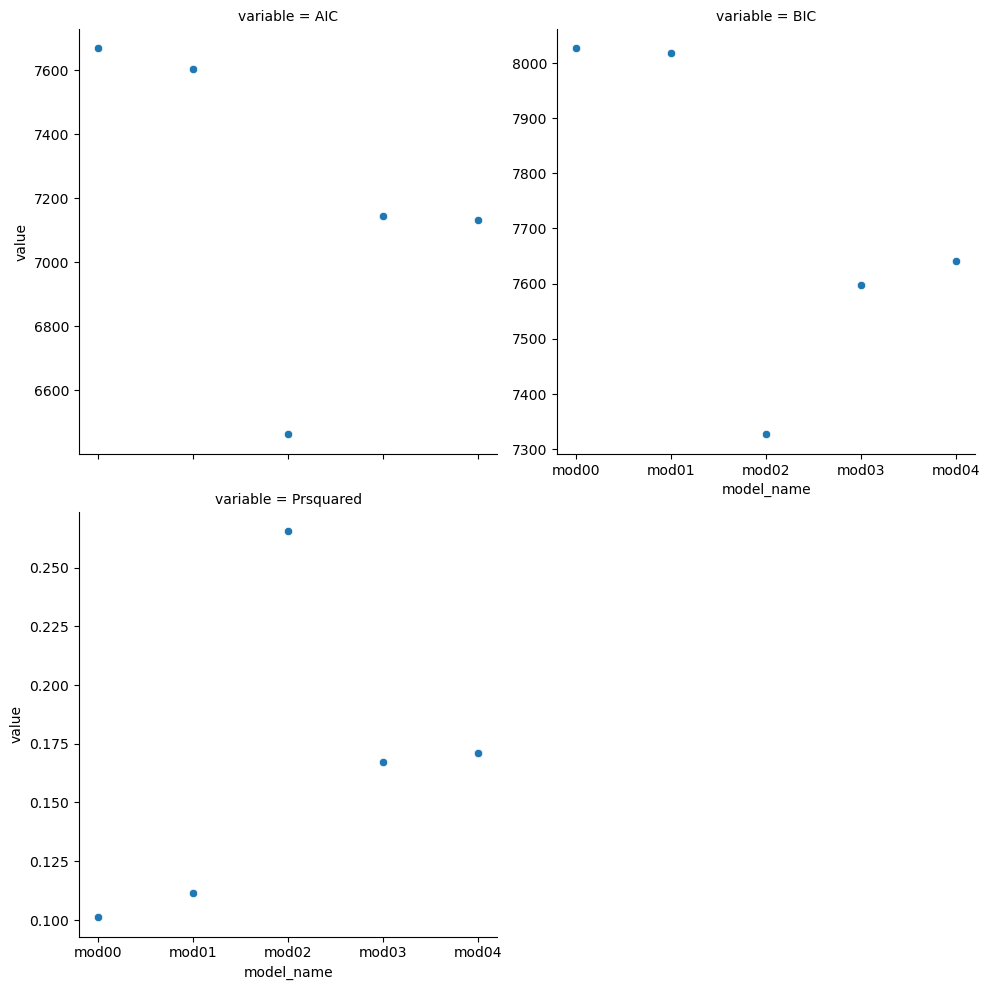

In [61]:
sns.relplot(data = model_results.melt(id_vars=['model_name']),
            x='model_name',
            y='value', 
            col='variable',
            col_wrap=2,
            facet_kws = {'sharey': False})

plt.show()

In [62]:
print(model_list[2].summary())

                          Poisson Regression Results                          
Dep. Variable:           final_events   No. Observations:                 2444
Model:                        Poisson   Df Residuals:                     2295
Method:                           MLE   Df Model:                          148
Date:                Thu, 27 Apr 2023   Pseudo R-squ.:                  0.2654
Time:                        07:52:47   Log-Likelihood:                -3082.0
converged:                       True   LL-Null:                       -4195.6
Covariance Type:            nonrobust   LLR p-value:                     0.000
                                  coef    std err          z      P>|z|      [0.025      0.975]
-----------------------------------------------------------------------------------------------
Intercept                       0.7877      0.132      5.972      0.000       0.529       1.046
sid[T.2]                       -0.7525      0.181     -4.147      0.000      -1.

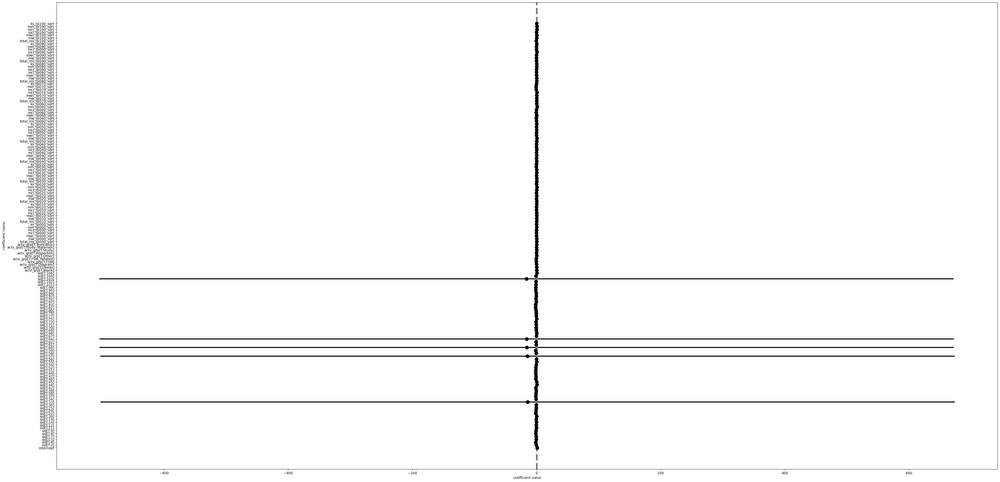

In [63]:
my_coefplot(model_list[2])

## Run PCA
This notebook standardizes the variables and performs PCA

In [64]:
features_df = sqrt_features_df.copy()

In [65]:
feature_names = sqrt_features_df.columns

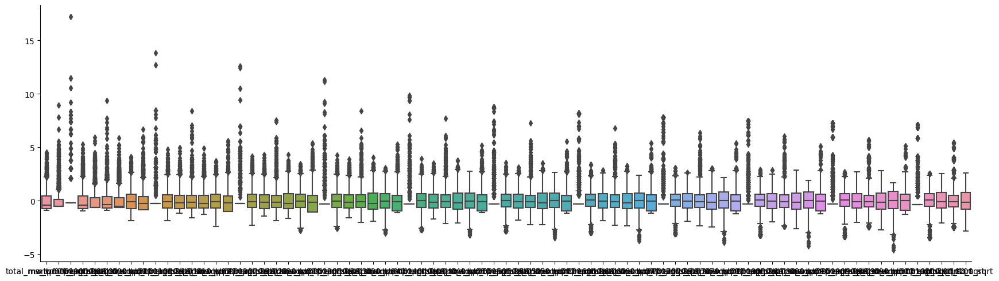

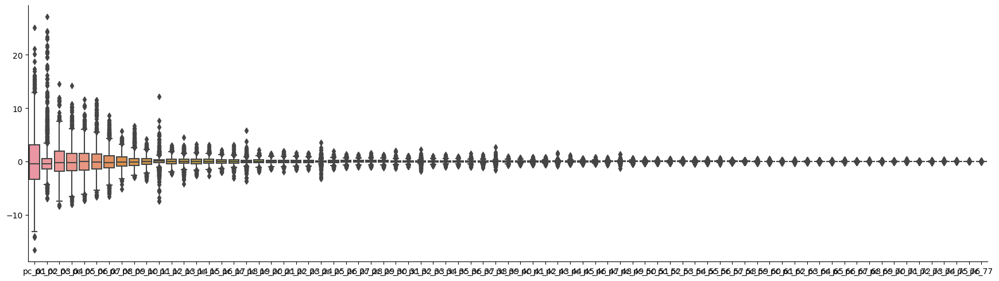

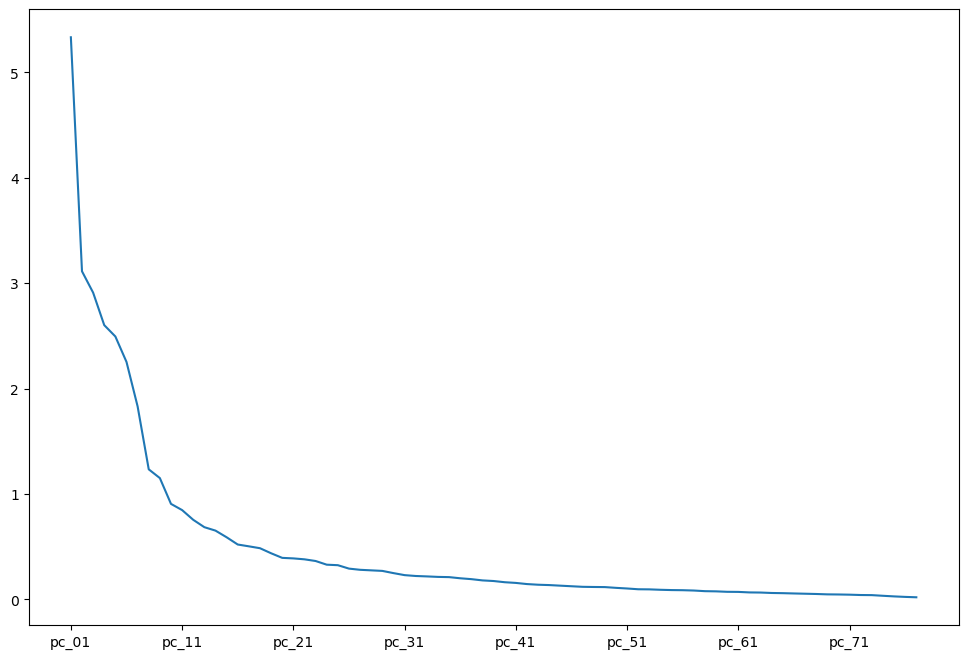

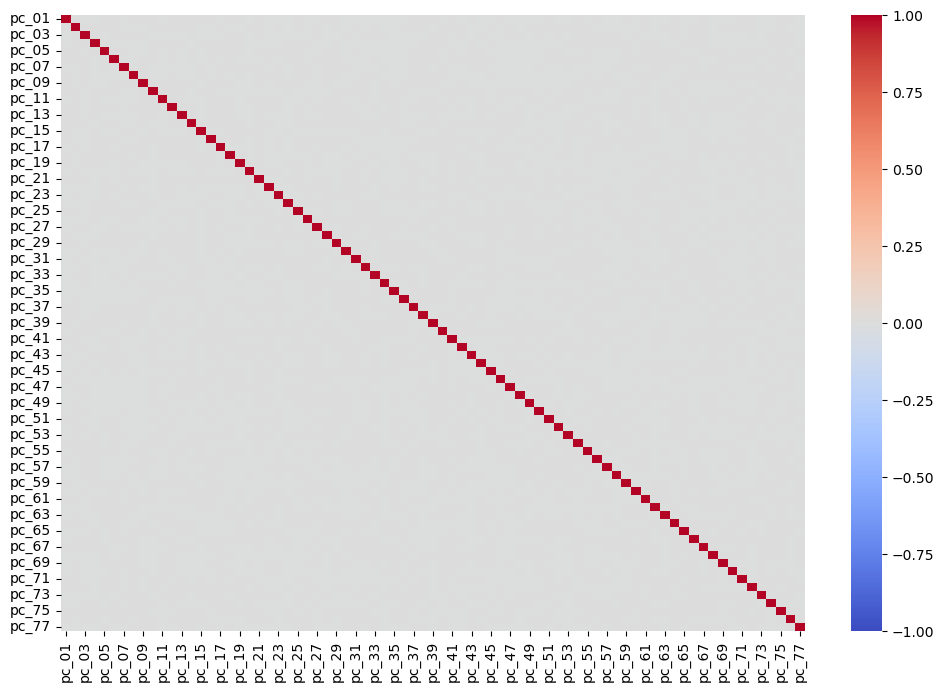

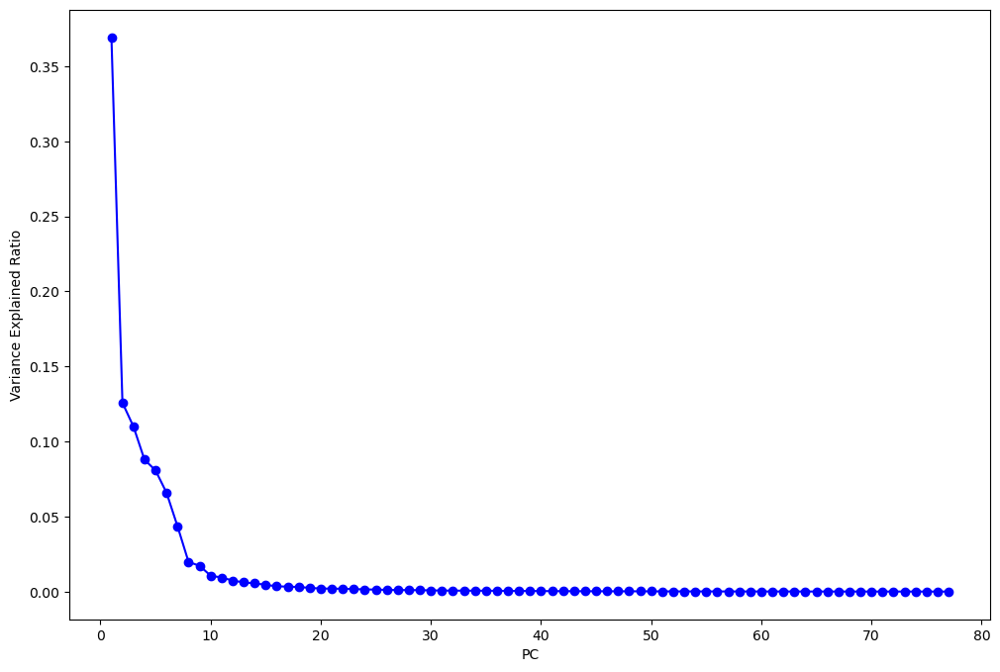

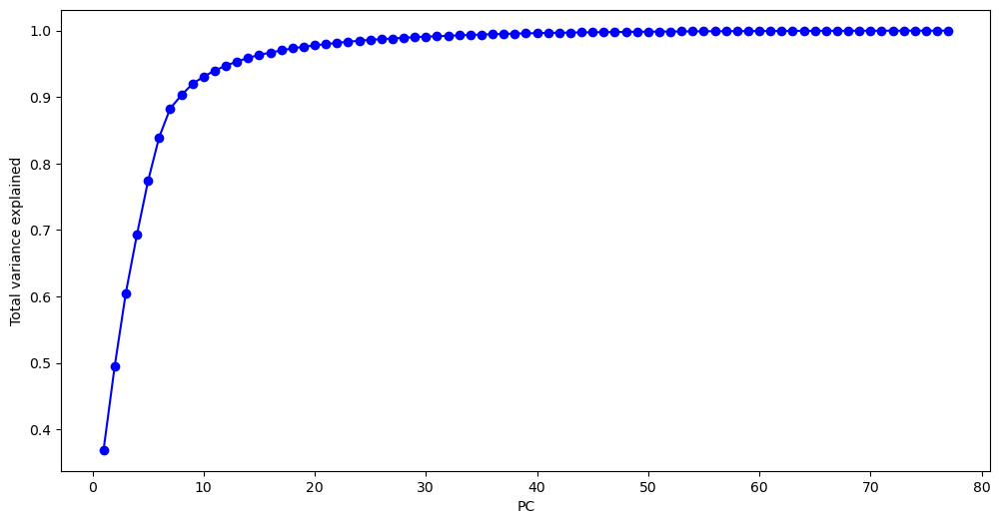

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2444 entries, 0 to 2443
Data columns (total 77 columns):
 #   Column  Non-Null Count  Dtype  
---  ------  --------------  -----  
 0   PC01    2444 non-null   float64
 1   PC02    2444 non-null   float64
 2   PC03    2444 non-null   float64
 3   PC04    2444 non-null   float64
 4   PC05    2444 non-null   float64
 5   PC06    2444 non-null   float64
 6   PC07    2444 non-null   float64
 7   PC08    2444 non-null   float64
 8   PC09    2444 non-null   float64
 9   PC10    2444 non-null   float64
 10  PC11    2444 non-null   float64
 11  PC12    2444 non-null   float64
 12  PC13    2444 non-null   float64
 13  PC14    2444 non-null   float64
 14  PC15    2444 non-null   float64
 15  PC16    2444 non-null   float64
 16  PC17    2444 non-null   float64
 17  PC18    2444 non-null   float64
 18  PC19    2444 non-null   float64
 19  PC20    2444 non-null   float64
 20  PC21    2444 non-null   float64
 21  PC22    2444 non-null   float64
 22  

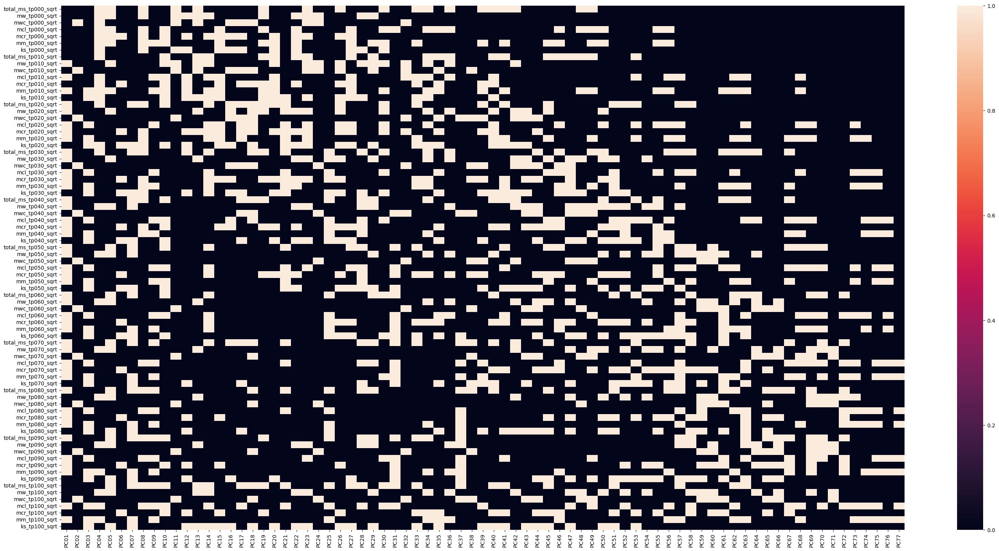

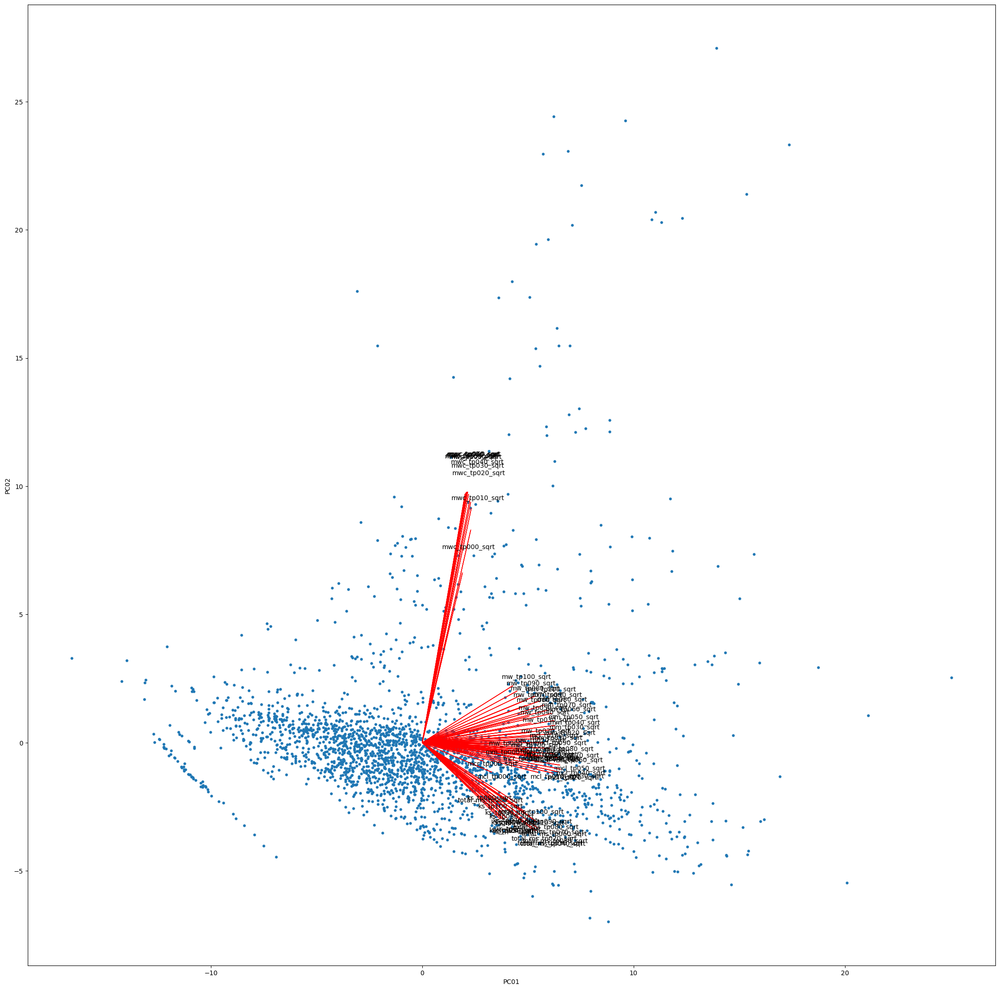

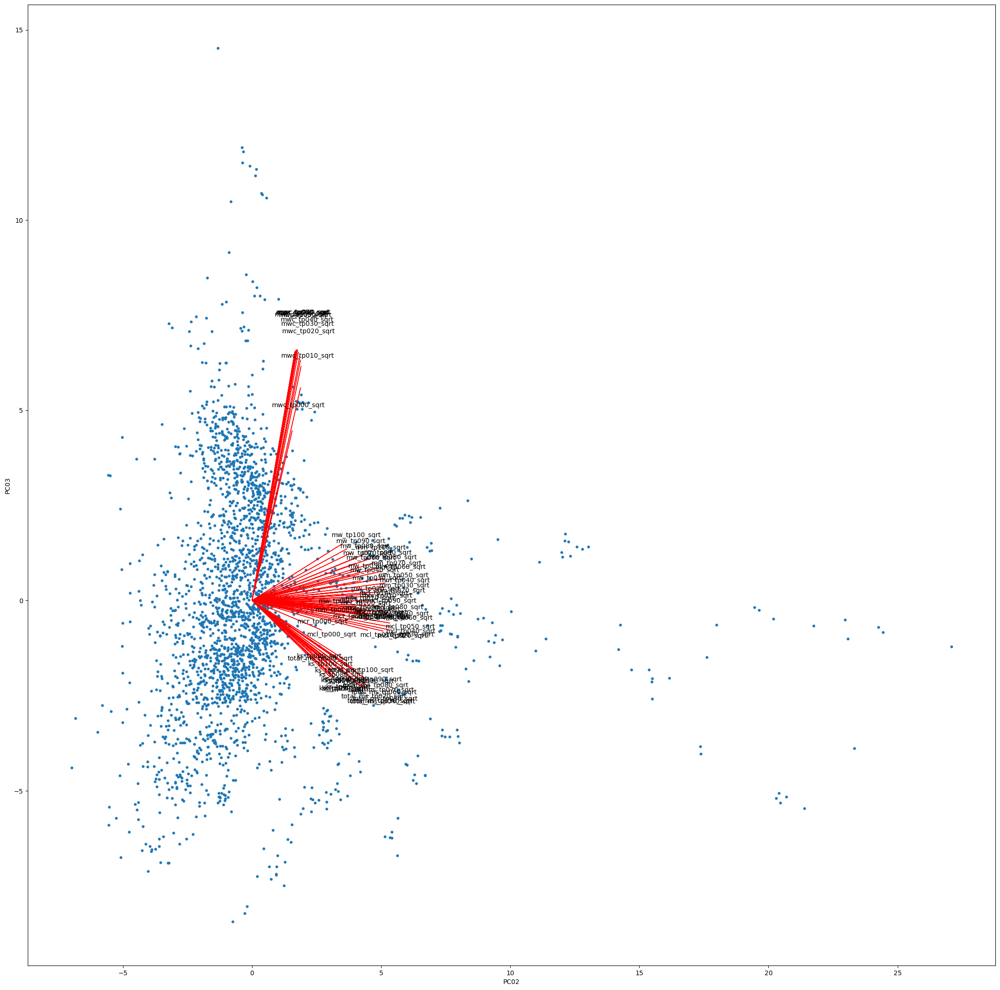

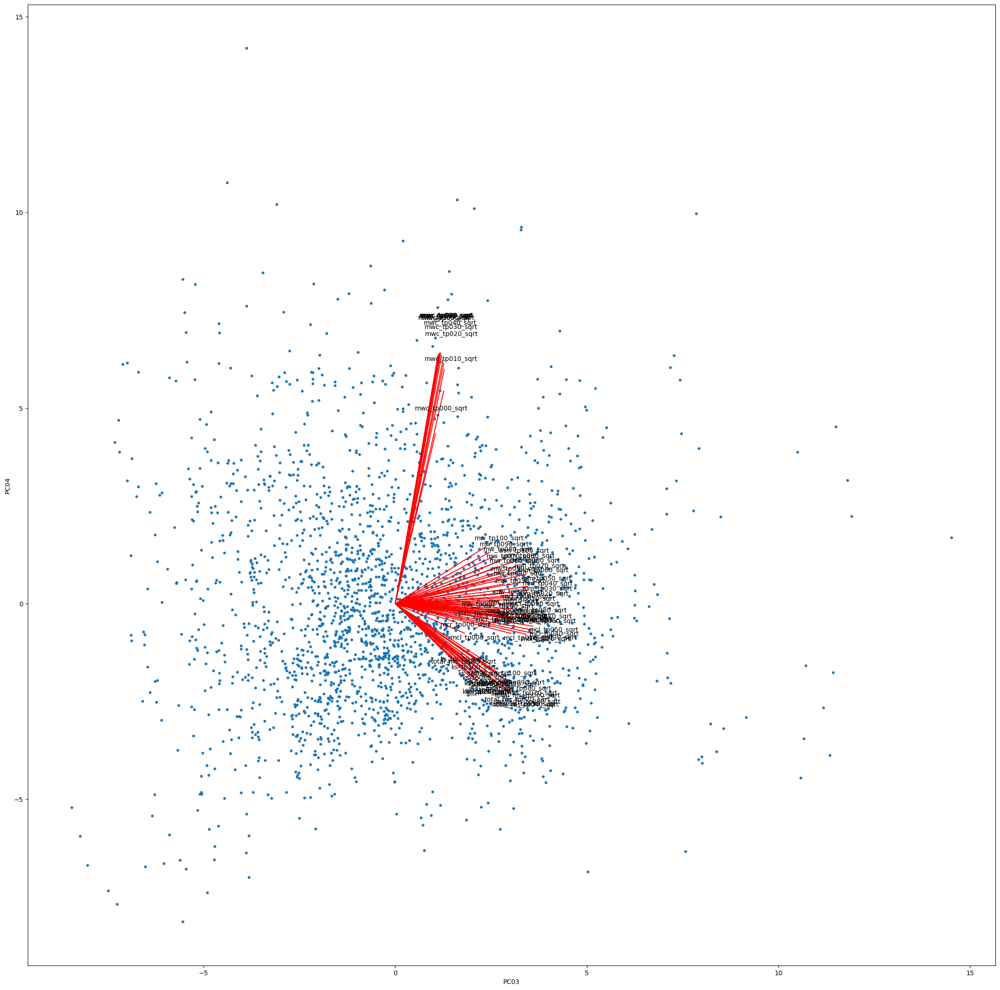

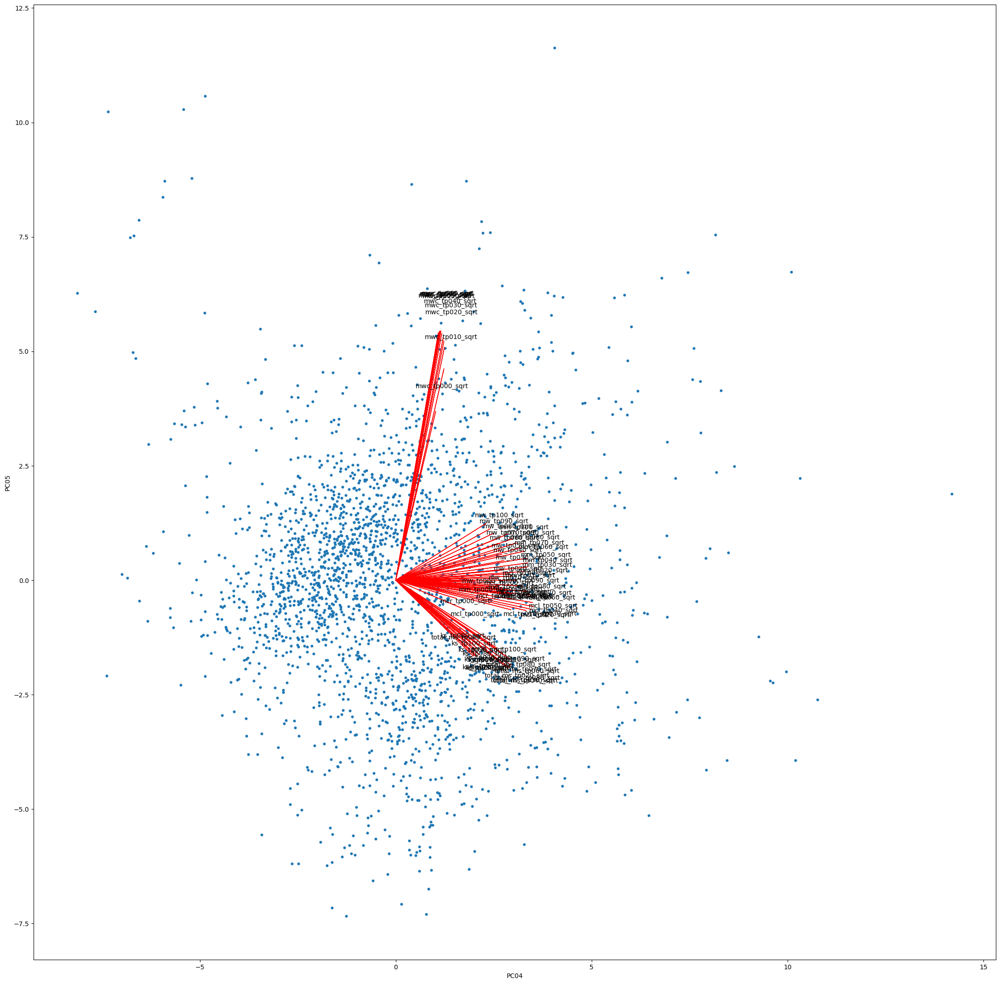

In [66]:
%run CMPINF2120_EPM_PCA_INCL_Over_Lisa.ipynb

In [67]:
first_pc_scores_df = pc_scores_df.copy()

#### Create a dataset with key, categorical, and output variables from `input_sqrt_df` and PCs from `pc_scores_df`

In [68]:
first_pc_scores_df.head()

,PC01,PC02,PC03,PC04,PC05,PC06,PC07,PC08,PC09,PC10,...,PC68,PC69,PC70,PC71,PC72,PC73,PC74,PC75,PC76,PC77
0,-1.343494,0.614381,3.048655,-2.980032,-0.717602,-2.483105,-0.946123,-0.109224,0.802887,0.573025,...,0.021226,0.007764,-0.042438,0.007726,0.016882,-0.033860,-0.020212,-0.020811,0.002340,0.013947
1,2.264423,-0.252348,3.635242,-1.695365,-0.567017,-2.818182,-1.183510,-1.495354,0.493679,1.094633,...,-0.054488,0.016730,0.010136,-0.022828,-0.049764,-0.025509,-0.011965,-0.003058,0.010145,-0.003176
2,2.407197,-0.285384,3.514516,-1.835526,-0.700168,-2.871521,-1.200218,-1.409066,0.499980,0.042987,...,-0.008969,-0.002833,-0.015106,0.000015,-0.020132,-0.009533,-0.014708,0.001780,0.028581,-0.000724
3,1.800267,-0.177009,3.836746,-0.226538,0.360890,-3.378267,-1.494108,1.350565,1.428391,-0.292023,...,-0.052102,0.019233,-0.019455,-0.021534,-0.068026,-0.055084,0.009613,0.001835,-0.002256,-0.030537
4,2.285621,-0.236315,3.690869,-1.931407,-0.768909,-2.861841,-1.110547,-1.684833,0.437358,0.939661,...,-0.031325,-0.003566,0.041341,-0.008955,-0.027152,-0.000594,-0.012622,0.027929,0.006442,-0.031819


In [69]:
final_sqrt_df.head()

,sess,sid,actv_grp,total_ms_tp000_sqrt,mw_tp000_sqrt,mwc_tp000_sqrt,mcl_tp000_sqrt,mcr_tp000_sqrt,mm_tp000_sqrt,ks_tp000_sqrt,...,ks_tp090_sqrt,total_ms_tp100_sqrt,mw_tp100_sqrt,mwc_tp100_sqrt,mcl_tp100_sqrt,mcr_tp100_sqrt,mm_tp100_sqrt,ks_tp100_sqrt,final_events,final_trials
0,1,1,Aulaweb,89.442719,0.000000,0.0,2.000000,0.000000,21.931712,0.000000,...,31.572140,2563.981279,21.213203,0.0,65.696271,17.146428,570.063154,34.409301,2.0,2.0
1,1,1,Blank,89.442719,0.000000,0.0,2.000000,0.000000,23.237900,0.000000,...,31.629101,2562.420730,21.166010,0.0,65.635356,17.146428,569.584937,34.409301,2.0,2.0
2,1,1,Deeds,202.484567,2.449490,0.0,3.464102,0.000000,46.054316,2.000000,...,31.559468,2492.789602,20.688161,0.0,63.812225,16.852300,554.692708,33.346664,2.0,2.0
3,1,1,Diagram,939.148551,5.567764,0.0,21.447611,7.348469,183.891272,4.582576,...,31.272992,2546.566316,20.688161,0.0,65.038450,17.088007,564.874322,33.346664,2.0,2.0
4,1,1,Other,31.622777,0.000000,0.0,0.000000,0.000000,9.165151,0.000000,...,31.811947,2562.420730,21.166010,0.0,65.620119,17.146428,569.535776,34.409301,2.0,2.0


In [70]:
final_sqrt_df.loc[:, ['sess','sid','actv_grp','final_events','final_trials']]

,sess,sid,actv_grp,final_events,final_trials
0,1,1,Aulaweb,2.0,2.0
1,1,1,Blank,2.0,2.0
2,1,1,Deeds,2.0,2.0
3,1,1,Diagram,2.0,2.0
4,1,1,Other,2.0,2.0
...,...,...,...,...,...
2439,6,102,FSM_Related,0.0,2.0
2440,6,102,Other,0.0,2.0
2441,6,102,Properties,0.0,2.0
2442,6,102,Study,0.0,2.0


In [71]:
pd.concat([final_sqrt_df.loc[:,['sess','sid','actv_grp','final_events','final_trials']].copy(), first_pc_scores_df], axis=1)

,sess,sid,actv_grp,final_events,final_trials,PC01,PC02,PC03,PC04,PC05,...,PC68,PC69,PC70,PC71,PC72,PC73,PC74,PC75,PC76,PC77
0,1,1,Aulaweb,2.0,2.0,-1.343494,0.614381,3.048655,-2.980032,-0.717602,...,0.021226,0.007764,-0.042438,0.007726,0.016882,-0.033860,-0.020212,-0.020811,0.002340,0.013947
1,1,1,Blank,2.0,2.0,2.264423,-0.252348,3.635242,-1.695365,-0.567017,...,-0.054488,0.016730,0.010136,-0.022828,-0.049764,-0.025509,-0.011965,-0.003058,0.010145,-0.003176
2,1,1,Deeds,2.0,2.0,2.407197,-0.285384,3.514516,-1.835526,-0.700168,...,-0.008969,-0.002833,-0.015106,0.000015,-0.020132,-0.009533,-0.014708,0.001780,0.028581,-0.000724
3,1,1,Diagram,2.0,2.0,1.800267,-0.177009,3.836746,-0.226538,0.360890,...,-0.052102,0.019233,-0.019455,-0.021534,-0.068026,-0.055084,0.009613,0.001835,-0.002256,-0.030537
4,1,1,Other,2.0,2.0,2.285621,-0.236315,3.690869,-1.931407,-0.768909,...,-0.031325,-0.003566,0.041341,-0.008955,-0.027152,-0.000594,-0.012622,0.027929,0.006442,-0.031819
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2439,6,102,FSM_Related,0.0,2.0,1.539805,-0.209572,5.056273,-0.625754,1.067768,...,-0.051070,0.002365,-0.015540,0.000878,-0.008006,0.012859,-0.005245,-0.003537,-0.004329,0.007108
2440,6,102,Other,0.0,2.0,-3.926028,1.379748,3.355224,-4.322836,0.003769,...,-0.022156,0.008253,-0.027522,-0.007256,0.063841,-0.014692,0.001131,-0.003470,0.003893,-0.011124
2441,6,102,Properties,0.0,2.0,1.810717,-0.137528,5.400015,-0.807313,1.201469,...,-0.004866,-0.000190,-0.007158,-0.008692,-0.018735,-0.015721,-0.015870,0.008795,-0.032018,0.004263
2442,6,102,Study,0.0,2.0,0.895392,0.111307,4.748045,-2.764785,-0.059818,...,0.002408,-0.067429,0.027239,0.034184,0.016383,-0.008254,0.006501,-0.013523,-0.007994,0.010186


In [72]:
pc_df_to_model = pd.concat([final_sqrt_df.loc[:,['sess','sid','actv_grp','final_events','final_trials']].copy(), pc_scores_df.copy()], axis=1)

In [73]:
pc_features = ['PC01','PC02','PC03','PC04','PC05','PC06','PC07','PC08']

In [74]:
pc_features_str = ''
for ix, x in enumerate(pc_features):
    if ix == len(pc_features) - 1:
        pc_features_str = pc_features_str + x
    else:
        pc_features_str = pc_features_str + x + ' + '
pc_features_str

'PC01 + PC02 + PC03 + PC04 + PC05 + PC06 + PC07 + PC08'

In [75]:
pc_y, pc_X = dmatrices('final_events ~ (' + pc_features_str + ')**2', data=pc_df_to_model, return_type='dataframe')

In [76]:
pc_X.head()

,Intercept,PC01,PC02,PC03,PC04,PC05,PC06,PC07,PC08,PC01:PC02,...,PC04:PC05,PC04:PC06,PC04:PC07,PC04:PC08,PC05:PC06,PC05:PC07,PC05:PC08,PC06:PC07,PC06:PC08,PC07:PC08
0,1.0,-1.343494,0.614381,3.048655,-2.980032,-0.717602,-2.483105,-0.946123,-0.109224,-0.825417,...,2.138478,7.399732,2.819477,0.325492,1.781882,0.678940,0.078380,2.349322,0.271215,0.103340
1,1.0,2.264423,-0.252348,3.635242,-1.695365,-0.567017,-2.818182,-1.183510,-1.495354,-0.571422,...,0.961300,4.777845,2.006481,2.535169,1.597957,0.671070,0.847891,3.335346,4.214178,1.769766
2,1.0,2.407197,-0.285384,3.514516,-1.835526,-0.700168,-2.871521,-1.200218,-1.409066,-0.686975,...,1.285177,5.270754,2.203032,2.586378,2.010548,0.840355,0.986583,3.446452,4.046164,1.691187
3,1.0,1.800267,-0.177009,3.836746,-0.226538,0.360890,-3.378267,-1.494108,1.350565,-0.318664,...,-0.081755,0.765305,0.338472,-0.305954,-1.219183,-0.539209,0.487405,5.047496,-4.562567,-2.017889
4,1.0,2.285621,-0.236315,3.690869,-1.931407,-0.768909,-2.861841,-1.110547,-1.684833,-0.540126,...,1.485077,5.527380,2.144918,3.254098,2.200496,0.853909,1.295483,3.178208,4.821723,1.871085


In [77]:
pc_X.columns

Index(['Intercept', 'PC01', 'PC02', 'PC03', 'PC04', 'PC05', 'PC06', 'PC07',
       'PC08', 'PC01:PC02', 'PC01:PC03', 'PC01:PC04', 'PC01:PC05', 'PC01:PC06',
       'PC01:PC07', 'PC01:PC08', 'PC02:PC03', 'PC02:PC04', 'PC02:PC05',
       'PC02:PC06', 'PC02:PC07', 'PC02:PC08', 'PC03:PC04', 'PC03:PC05',
       'PC03:PC06', 'PC03:PC07', 'PC03:PC08', 'PC04:PC05', 'PC04:PC06',
       'PC04:PC07', 'PC04:PC08', 'PC05:PC06', 'PC05:PC07', 'PC05:PC08',
       'PC06:PC07', 'PC06:PC08', 'PC07:PC08'],
      dtype='object')

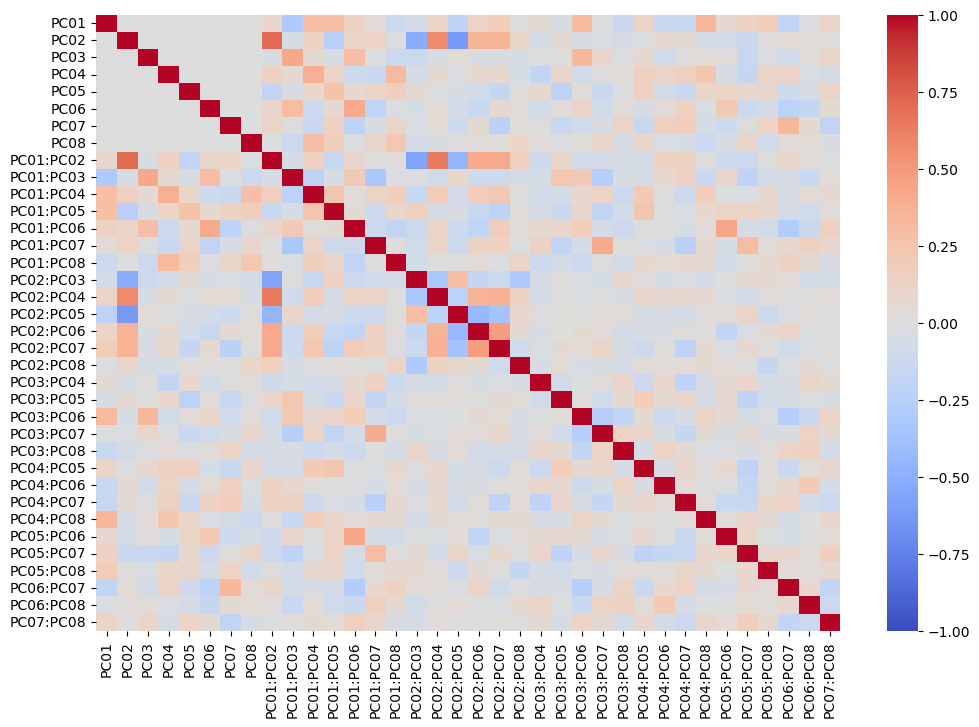

In [78]:
fig, ax = plt.subplots(figsize=(12, 8))

sns.heatmap(data = pc_X.drop(columns=['Intercept']).corr(), 
            vmin=-1, vmax=1, center = 0,
            cmap='coolwarm', 
            ax=ax)

plt.show()

In [79]:
features_df = pc_X.drop(columns=['Intercept']).copy()

In [80]:
feature_names = features_df.columns

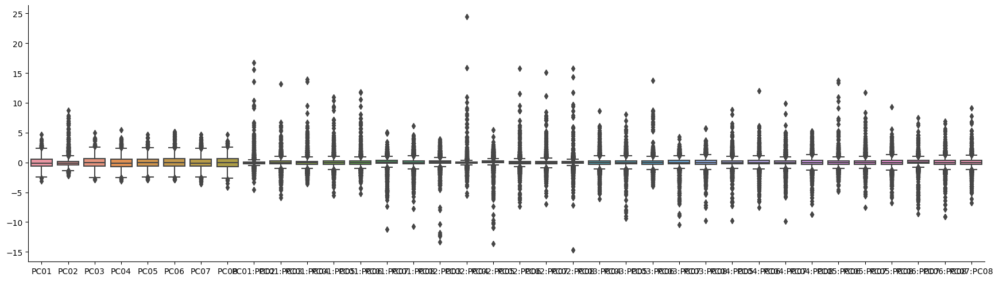

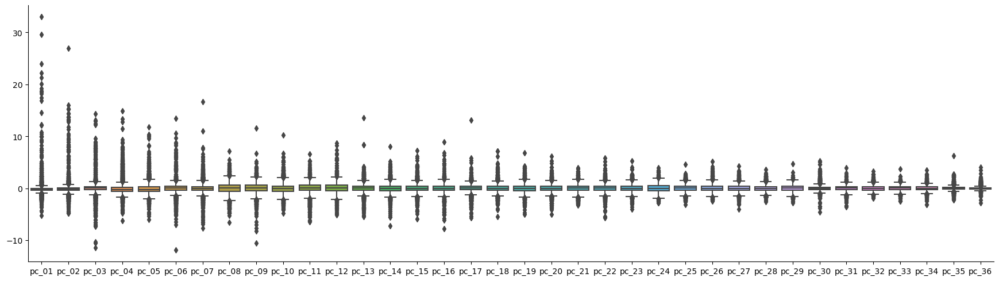

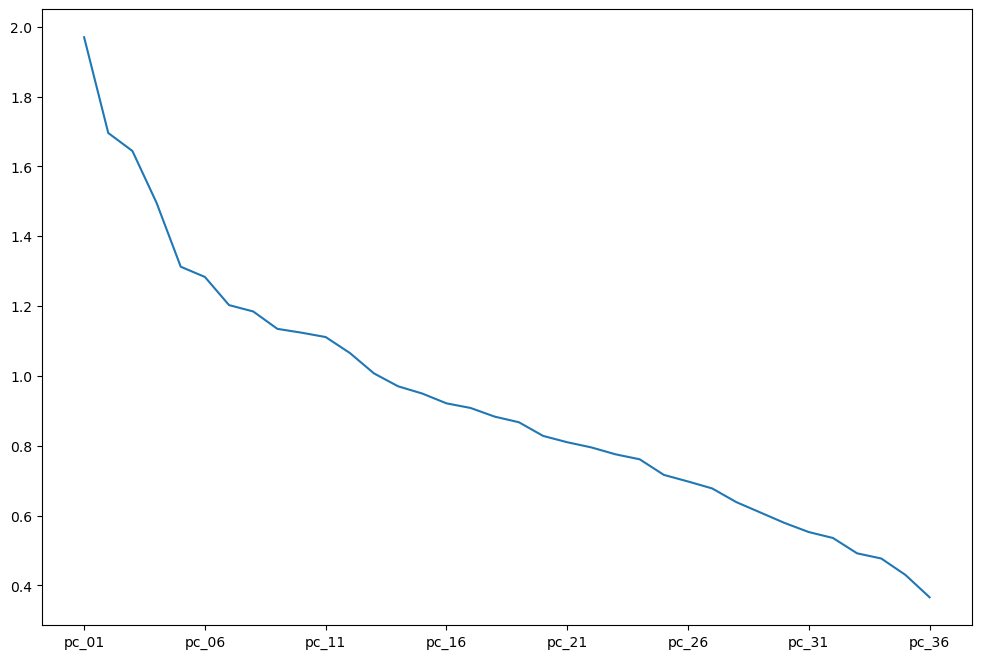

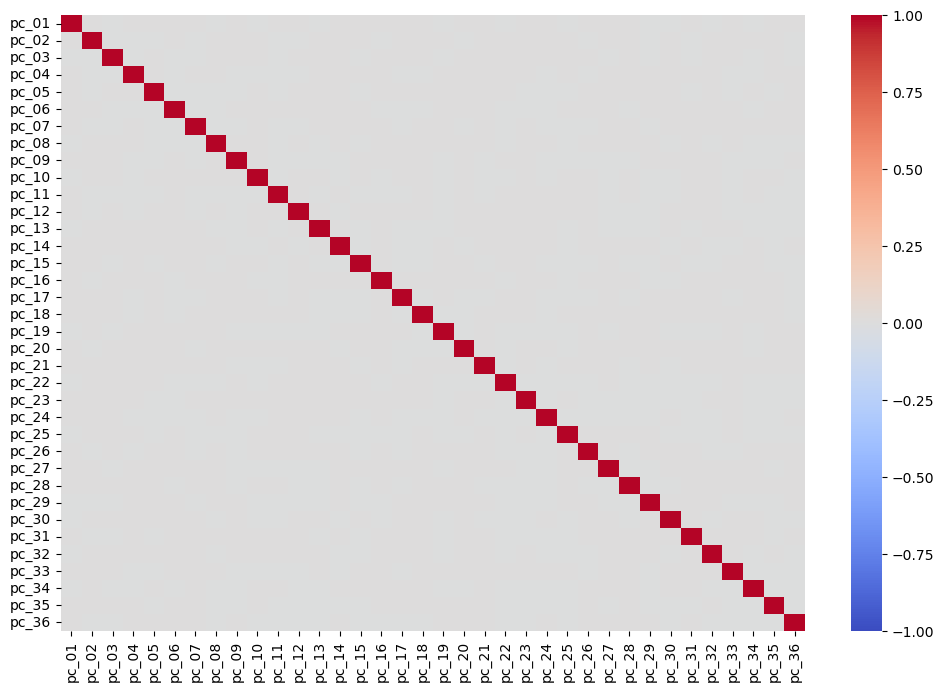

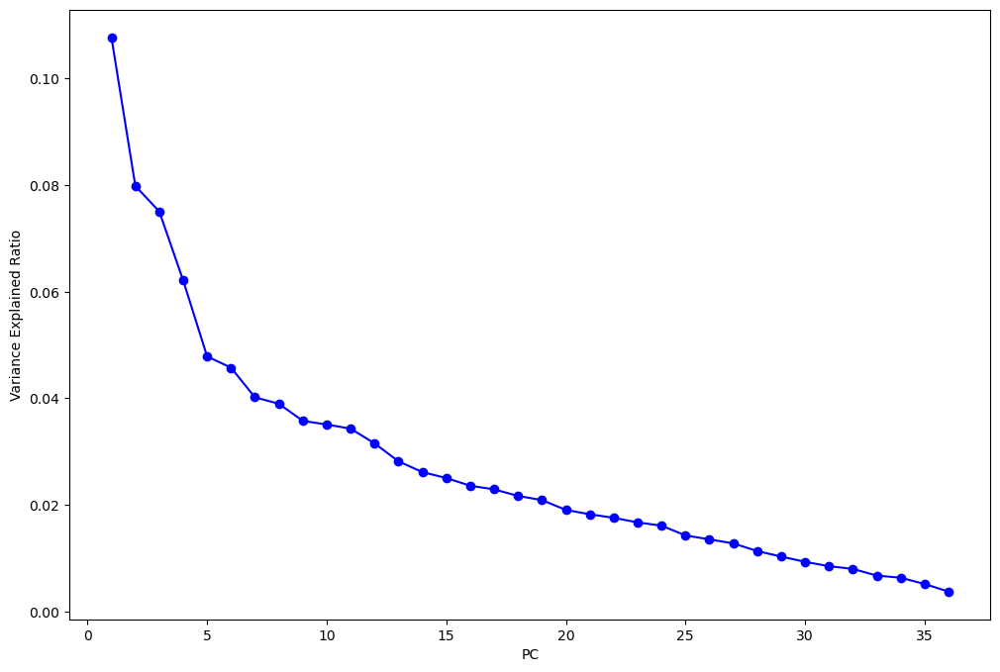

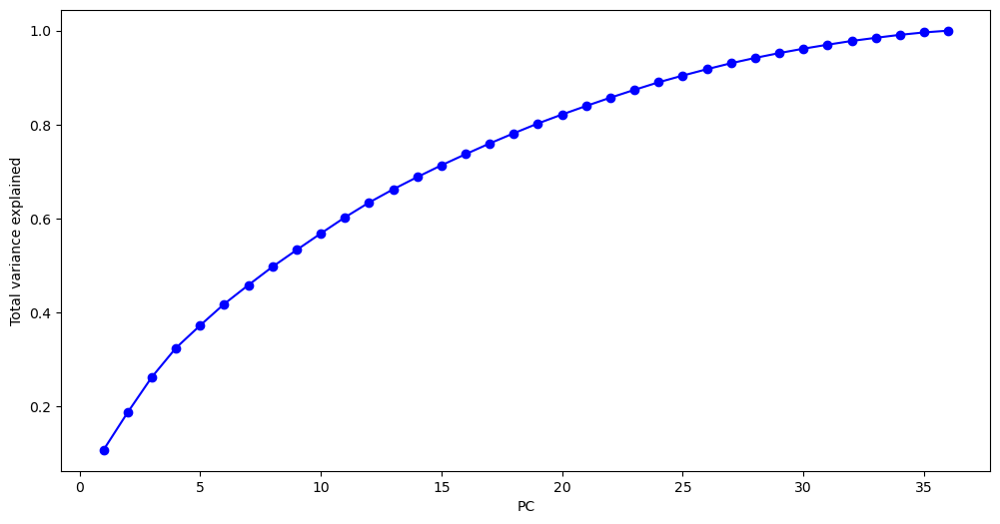

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2444 entries, 0 to 2443
Data columns (total 36 columns):
 #   Column  Non-Null Count  Dtype  
---  ------  --------------  -----  
 0   PC01    2444 non-null   float64
 1   PC02    2444 non-null   float64
 2   PC03    2444 non-null   float64
 3   PC04    2444 non-null   float64
 4   PC05    2444 non-null   float64
 5   PC06    2444 non-null   float64
 6   PC07    2444 non-null   float64
 7   PC08    2444 non-null   float64
 8   PC09    2444 non-null   float64
 9   PC10    2444 non-null   float64
 10  PC11    2444 non-null   float64
 11  PC12    2444 non-null   float64
 12  PC13    2444 non-null   float64
 13  PC14    2444 non-null   float64
 14  PC15    2444 non-null   float64
 15  PC16    2444 non-null   float64
 16  PC17    2444 non-null   float64
 17  PC18    2444 non-null   float64
 18  PC19    2444 non-null   float64
 19  PC20    2444 non-null   float64
 20  PC21    2444 non-null   float64
 21  PC22    2444 non-null   float64
 22  

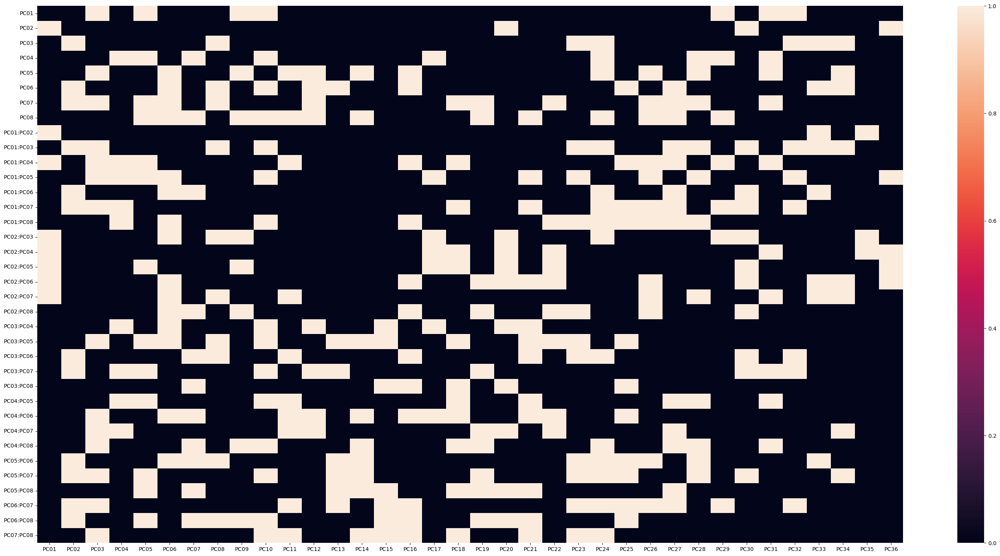

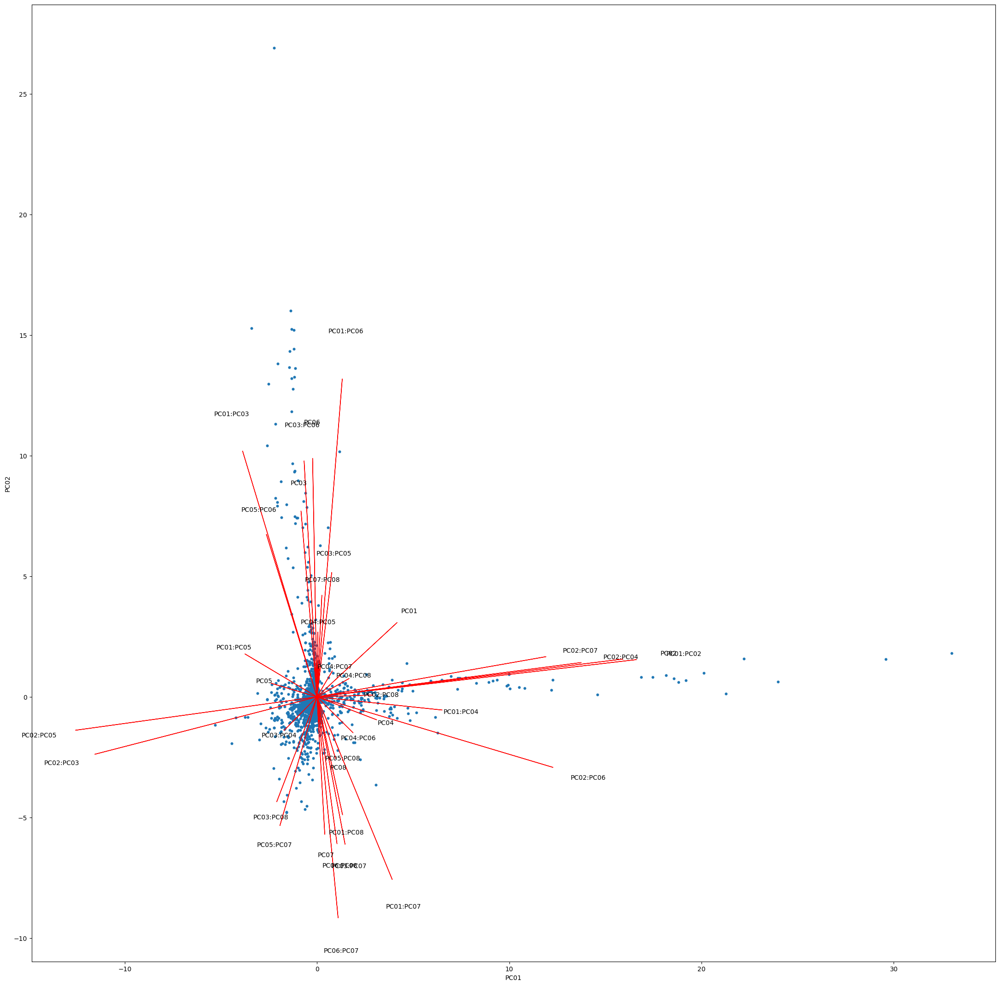

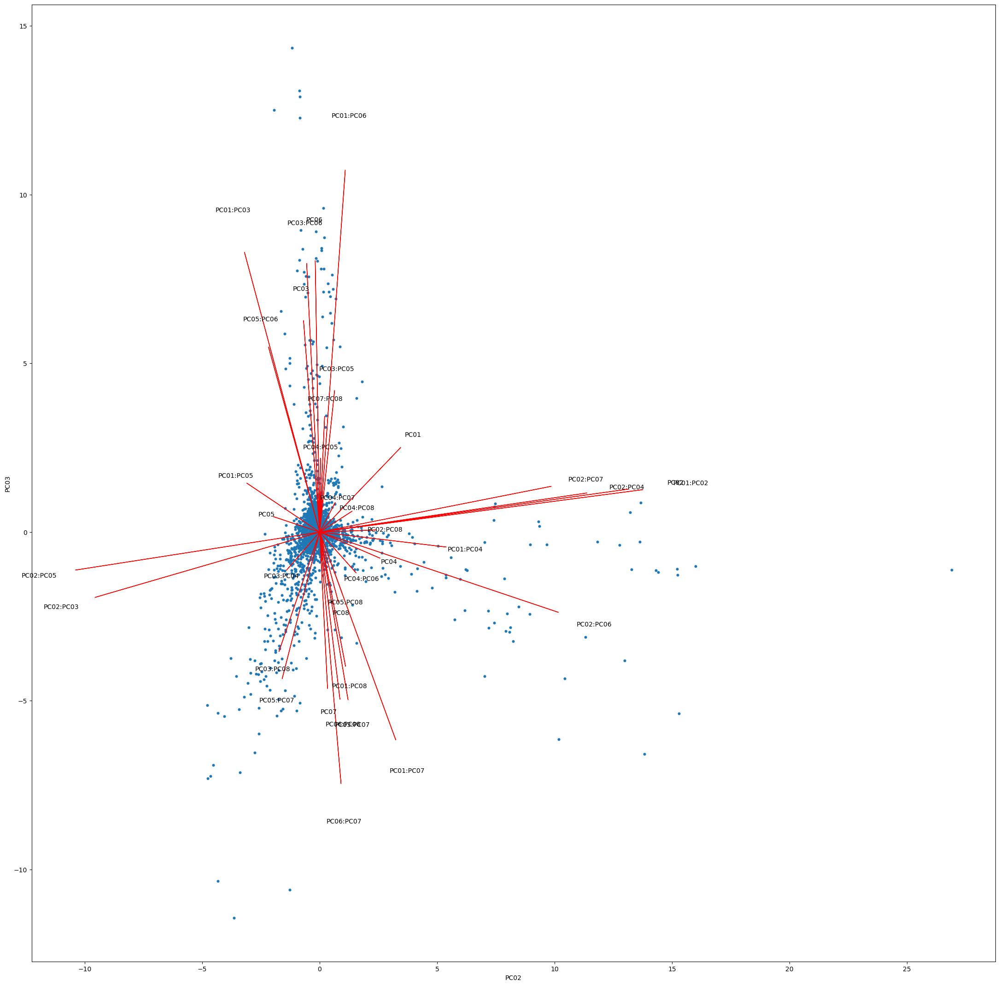

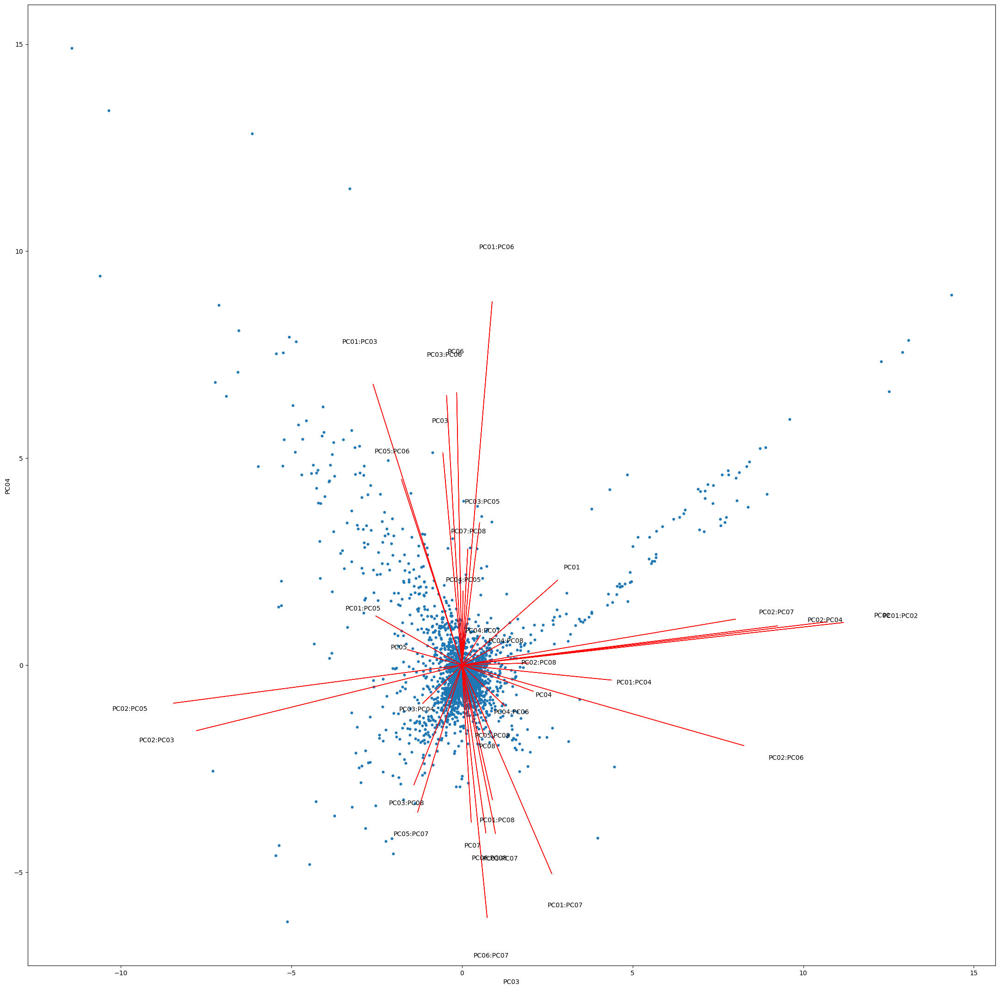

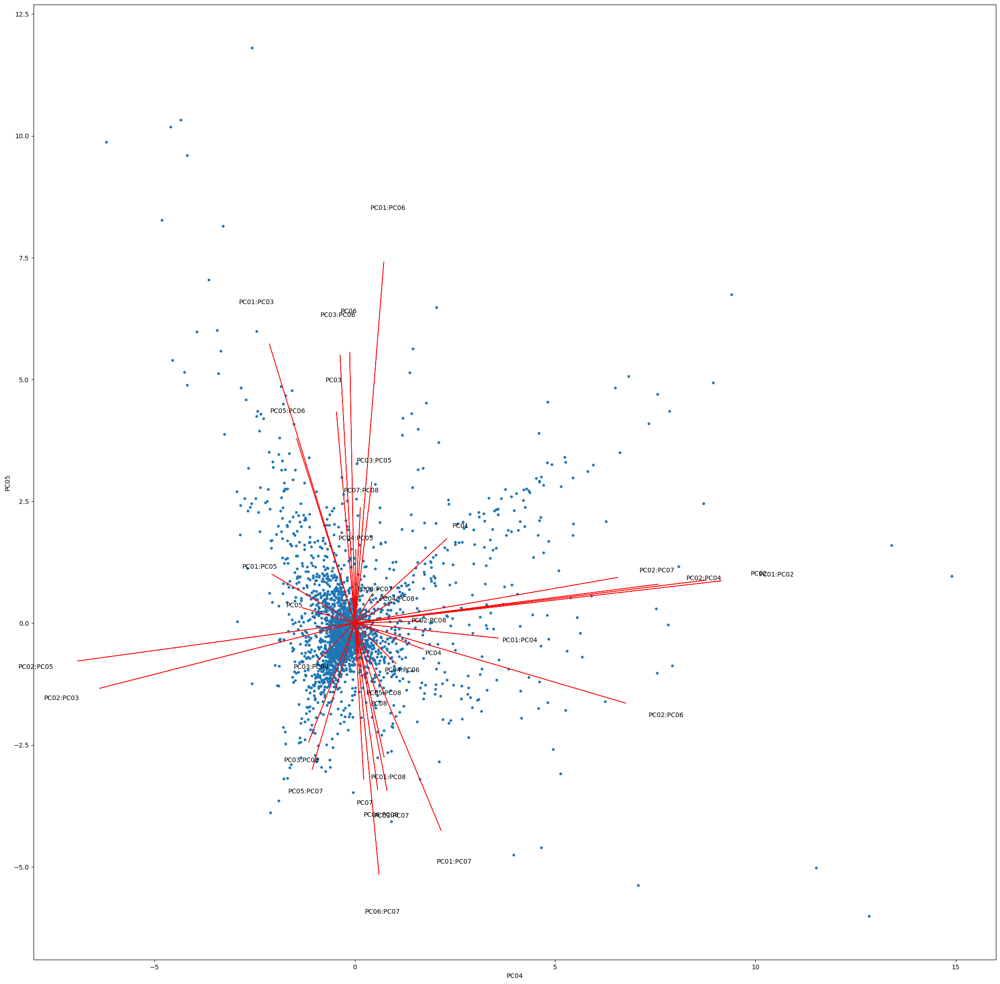

In [81]:
%run CMPINF2120_EPM_PCA_INCL_Over_Lisa.ipynb

In [82]:
pc_scores_df.shape

(2444, 36)

## Poisson Regression with PCA

In [83]:
pc_descr_formulas = ['final_events ~ sid'
                    ,'final_events ~ sid + actv_grp'
                    ,'final_events ~ sid + actv_grp + ' + pc_features_str
                    ,'final_events ~ sid * (' + pc_features_str + ')'
                    ,'final_events ~ sid * (actv_grp + ' + pc_features_str + ')'
                    ]

In [84]:
pc_pred_formulas = ['final_events ~ ' + pc_features_str
                    ,'final_events ~ (' + pc_features_str + ')**2'
                    ,'final_events ~ actv_grp + ' + pc_features_str
                    ,'final_events ~ actv_grp * (' + pc_features_str + ')'
                    ,'final_events ~ actv_grp + (' + pc_features_str + ')**2'
                    ,'final_events ~ actv_grp * (' + pc_features_str + ')**2'
                   ]

In [85]:
pc_formula_test_list = pc_descr_formulas + pc_pred_formulas

In [86]:
pc_formula_test_list

['final_events ~ sid',
 'final_events ~ sid + actv_grp',
 'final_events ~ sid + actv_grp + PC01 + PC02 + PC03 + PC04 + PC05 + PC06 + PC07 + PC08',
 'final_events ~ sid * (PC01 + PC02 + PC03 + PC04 + PC05 + PC06 + PC07 + PC08)',
 'final_events ~ sid * (actv_grp + PC01 + PC02 + PC03 + PC04 + PC05 + PC06 + PC07 + PC08)',
 'final_events ~ PC01 + PC02 + PC03 + PC04 + PC05 + PC06 + PC07 + PC08',
 'final_events ~ (PC01 + PC02 + PC03 + PC04 + PC05 + PC06 + PC07 + PC08)**2',
 'final_events ~ actv_grp + PC01 + PC02 + PC03 + PC04 + PC05 + PC06 + PC07 + PC08',
 'final_events ~ actv_grp * (PC01 + PC02 + PC03 + PC04 + PC05 + PC06 + PC07 + PC08)',
 'final_events ~ actv_grp + (PC01 + PC02 + PC03 + PC04 + PC05 + PC06 + PC07 + PC08)**2',
 'final_events ~ actv_grp * (PC01 + PC02 + PC03 + PC04 + PC05 + PC06 + PC07 + PC08)**2']

In [87]:
##### Evaluate the number of features with dmatrices

In [88]:
pc_sk_list = make_dmat(pc_df_to_model, pc_formula_test_list)

In [89]:
pc_model_dim = make_dim_df(pc_df_to_model, pc_sk_list, pc_formula_test_list)

In [90]:
pc_model_dim

,model name,dimensions,number of obs,dim < obs
0,0,62,2444,Yes
1,1,72,2444,Yes
2,2,80,2444,Yes
3,3,558,2444,Yes
4,4,1178,2444,Yes
5,5,9,2444,Yes
6,6,37,2444,Yes
7,7,19,2444,Yes
8,8,99,2444,Yes
9,9,47,2444,Yes


##### Errors occur even thought the number of features is less than the number of observations

In [91]:
pc_adjust_desc_formulas = ['final_events ~ sid'
                    ,'final_events ~ sid + actv_grp'
                    ,'final_events ~ sid + actv_grp + ' + pc_features_str
                    #,'final_events ~ sid * (' + pc_features_str + ')'
                    #,'final_events ~ sid * (actv_grp + ' + pc_features_str + ')'
                    ]

In [92]:
pc_adjust_pred_formulas = ['final_events ~ ' + pc_features_str
                    ,'final_events ~ (' + pc_features_str + ')**2'
                    ,'final_events ~ actv_grp + ' + pc_features_str
                    ,'final_events ~ actv_grp * (' + pc_features_str + ')'
                    ,'final_events ~ actv_grp + (' + pc_features_str + ')**2'
                    #,'final_events ~ actv_grp * (' + pc_features_str + ')**2'
                   ]

In [93]:
pc_formula_list = pc_adjust_desc_formulas + pc_adjust_pred_formulas

In [94]:
pc_formula_list

['final_events ~ sid',
 'final_events ~ sid + actv_grp',
 'final_events ~ sid + actv_grp + PC01 + PC02 + PC03 + PC04 + PC05 + PC06 + PC07 + PC08',
 'final_events ~ PC01 + PC02 + PC03 + PC04 + PC05 + PC06 + PC07 + PC08',
 'final_events ~ (PC01 + PC02 + PC03 + PC04 + PC05 + PC06 + PC07 + PC08)**2',
 'final_events ~ actv_grp + PC01 + PC02 + PC03 + PC04 + PC05 + PC06 + PC07 + PC08',
 'final_events ~ actv_grp * (PC01 + PC02 + PC03 + PC04 + PC05 + PC06 + PC07 + PC08)',
 'final_events ~ actv_grp + (PC01 + PC02 + PC03 + PC04 + PC05 + PC06 + PC07 + PC08)**2']

In [95]:
pc_model_list = []

for a_formula in pc_formula_list:
    #pc_model_list.append( smf.poisson( formula = a_formula, data = pc_df_to_model).fit(method='bfgs') )
    pc_model_list.append( smf.poisson( formula = a_formula, data = pc_df_to_model).fit(method='ncg') )
    #pc_model_list.append( smf.poisson( formula = a_formula, data = pc_df_to_model).fit(method='lbfgs') )
    #pc_model_list.append( smf.poisson( formula = a_formula, data = pc_df_to_model).fit(method='powell') )
    #pc_model_list.append( smf.poisson( formula = a_formula, data = pc_df_to_model).fit(method='newton') )
    #pc_model_list.append( smf.poisson( formula = a_formula, data = pc_df_to_model).fit(method='cg') )
    #pc_model_list.append( smf.poisson( formula = a_formula, data = pc_df_to_model).fit(method='basinhopping') )

Optimization terminated successfully.
         Current function value: 1.543124
         Iterations: 14
         Function evaluations: 15
         Gradient evaluations: 15
         Hessian evaluations: 14
Optimization terminated successfully.
         Current function value: 1.525616
         Iterations: 14
         Function evaluations: 15
         Gradient evaluations: 15
         Hessian evaluations: 14
Optimization terminated successfully.
         Current function value: 1.325239
         Iterations: 22
         Function evaluations: 24
         Gradient evaluations: 24
         Hessian evaluations: 22
Optimization terminated successfully.
         Current function value: 1.548077
         Iterations: 8
         Function evaluations: 9
         Gradient evaluations: 9
         Hessian evaluations: 8
Optimization terminated successfully.
         Current function value: 1.505923
         Iterations: 12
         Function evaluations: 13
         Gradient evaluations: 13
         Hes

In [96]:
pc_model_results = pd.DataFrame({'model_name': ['pc_mod00','pc_mod01','pc_mod02','pc_mod03','pc_mod04','pc_mod05','pc_mod06','pc_mod07'],
                              'AIC': [mod.aic for mod in pc_model_list],
                              'BIC': [mod.bic for mod in pc_model_list],
                              'Prsquared': [mod.prsquared for mod in pc_model_list]})

In [97]:
pc_model_results

,model_name,AIC,BIC,Prsquared
0,pc_mod00,7666.789117,8026.475379,0.101106
1,pc_mod01,7601.210361,8018.910536,0.111305
2,pc_mod02,6637.769417,7101.880723,0.228027
3,pc_mod03,7584.999588,7637.212110,0.098221
4,pc_mod04,7434.950334,7649.601813,0.122776
5,pc_mod05,7547.767911,7657.994346,0.105041
6,pc_mod06,7536.208790,8110.546531,0.125487
7,pc_mod07,7413.290030,7685.955422,0.127741


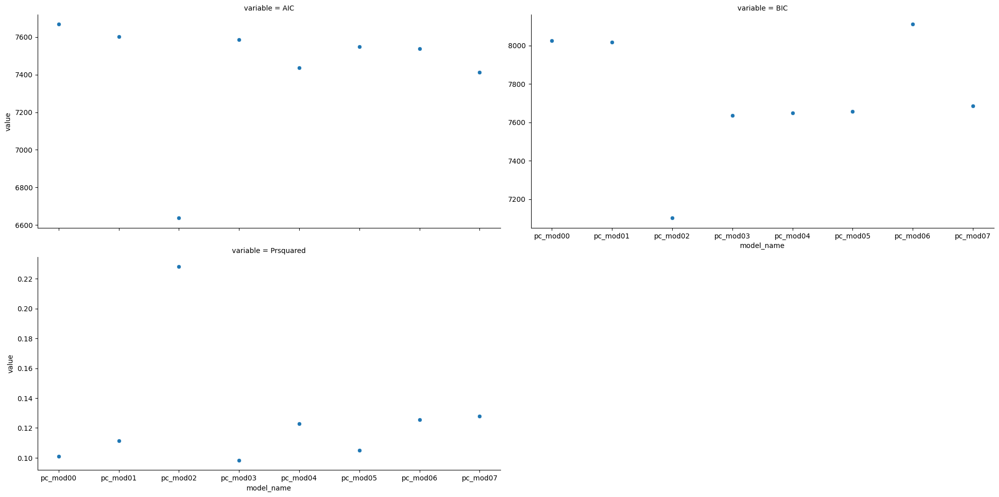

In [98]:
sns.relplot(data = pc_model_results.melt(id_vars=['model_name']),
            x='model_name',
            y='value', 
            col='variable',
            col_wrap=2,
            facet_kws = {'sharey': False},
            height=5, aspect=2)

plt.show()

In [99]:
print(pc_model_list[2].summary())

                          Poisson Regression Results                          
Dep. Variable:           final_events   No. Observations:                 2444
Model:                        Poisson   Df Residuals:                     2364
Method:                           MLE   Df Model:                           79
Date:                Thu, 27 Apr 2023   Pseudo R-squ.:                  0.2280
Time:                        07:52:57   Log-Likelihood:                -3238.9
converged:                       True   LL-Null:                       -4195.6
Covariance Type:            nonrobust   LLR p-value:                     0.000
                                  coef    std err          z      P>|z|      [0.025      0.975]
-----------------------------------------------------------------------------------------------
Intercept                       0.8569      0.125      6.841      0.000       0.611       1.102
sid[T.2]                       -0.6452      0.171     -3.766      0.000      -0.

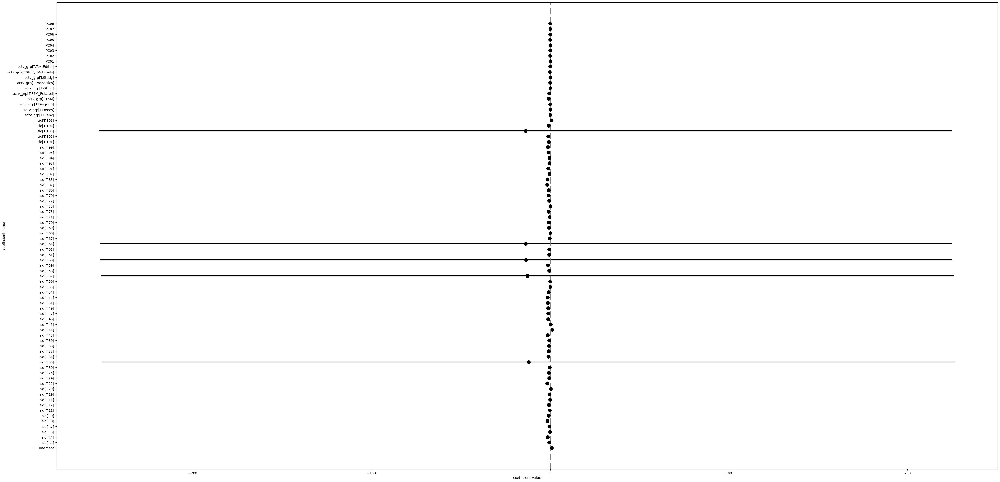

In [100]:
my_coefplot(pc_model_list[2])

#### The linear additive model with `sid` and `actv_grp` variables and the PC features is the best model

## Check the validity of the Poisson model

In [101]:
pc_df_to_model.final_events.mean()

1.376022913256956

In [102]:
pc_df_to_model.final_events.var()

2.3829041926797476

#### Compare the observed count to the fitted counts...undo the link, i.e., calculate the inverse link of the .fittedvalues attribute.

In [103]:
model_list[2].fittedvalues

0       1.127279
1       0.879788
2       0.913107
3       0.828572
4       1.117086
          ...   
2439   -1.544863
2440   -1.581286
2441   -1.119468
2442   -1.119786
2443   -1.420777
Length: 2444, dtype: float64

In [104]:
np.exp(model_list[2].fittedvalues)

0       3.087246
1       2.410388
2       2.492053
3       2.290045
4       3.055937
          ...   
2439    0.213341
2440    0.205710
2441    0.326453
2442    0.326350
2443    0.241526
Length: 2444, dtype: float64

In [105]:
df02 = pc_df_to_model.copy()

In [106]:
df02['avg_count'] = np.exp( pc_model_list[2].fittedvalues )

In [107]:
df02.head()

,sess,sid,actv_grp,final_events,final_trials,PC01,PC02,PC03,PC04,PC05,...,PC69,PC70,PC71,PC72,PC73,PC74,PC75,PC76,PC77,avg_count
0,1,1,Aulaweb,2.0,2.0,-1.343494,0.614381,3.048655,-2.980032,-0.717602,...,0.007764,-0.042438,0.007726,0.016882,-0.033860,-0.020212,-0.020811,0.002340,0.013947,1.782928
1,1,1,Blank,2.0,2.0,2.264423,-0.252348,3.635242,-1.695365,-0.567017,...,0.016730,0.010136,-0.022828,-0.049764,-0.025509,-0.011965,-0.003058,0.010145,-0.003176,2.297561
2,1,1,Deeds,2.0,2.0,2.407197,-0.285384,3.514516,-1.835526,-0.700168,...,-0.002833,-0.015106,0.000015,-0.020132,-0.009533,-0.014708,0.001780,0.028581,-0.000724,2.392456
3,1,1,Diagram,2.0,2.0,1.800267,-0.177009,3.836746,-0.226538,0.360890,...,0.019233,-0.019455,-0.021534,-0.068026,-0.055084,0.009613,0.001835,-0.002256,-0.030537,1.808362
4,1,1,Other,2.0,2.0,2.285621,-0.236315,3.690869,-1.931407,-0.768909,...,-0.003566,0.041341,-0.008955,-0.027152,-0.000594,-0.012622,0.027929,0.006442,-0.031819,2.362641


##### Calculate the new auxillary statistic

In [108]:
df02['t'] = ( (df02.final_events - df02.avg_count)**2 - df02.avg_count ) / df02.avg_count

In [109]:
aux_mod = smf.ols( 't ~ avg_count - 1', data = df02).fit()

In [110]:
print( aux_mod.summary() )

                                 OLS Regression Results                                
Dep. Variable:                      t   R-squared (uncentered):                   0.002
Model:                            OLS   Adj. R-squared (uncentered):              0.002
Method:                 Least Squares   F-statistic:                              4.881
Date:                Thu, 27 Apr 2023   Prob (F-statistic):                      0.0272
Time:                        07:52:57   Log-Likelihood:                         -4813.7
No. Observations:                2444   AIC:                                      9629.
Df Residuals:                    2443   BIC:                                      9635.
Df Model:                           1                                                  
Covariance Type:            nonrobust                                                  
                 coef    std err          t      P>|t|      [0.025      0.975]
-----------------------------------------

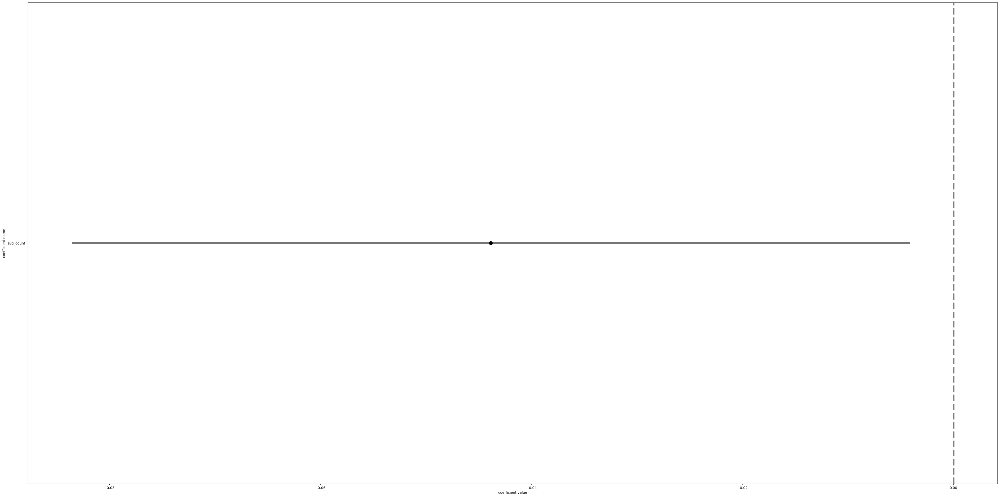

In [111]:
my_coefplot( aux_mod )

Model 02 is slightly underdispersed. The auxillary model's slope is **not** statistically significantly positive and the scale of the auxillary statistics and error bar is low in magnitude, so the Poisson regression assumption of Variance = mean is valid in this case.

## Negative Binomial Regression

### Negative Binomial without PCA

In [112]:
dm00_y, dm00_X = dmatrices('final_events ~ sid', data=final_sqrt_df, return_type='dataframe')
dm01_y, dm01_X = dmatrices('final_events ~ sid + actv_grp', data=final_sqrt_df, return_type='dataframe')
dm02_y, dm02_X = dmatrices('final_events ~ sid + actv_grp + ' + num_features_str, data=final_sqrt_df, return_type='dataframe')
dm03_y, dm03_X = dmatrices('final_events ~ ' + num_features_str, data=final_sqrt_df, return_type='dataframe')
dm04_y, dm04_X = dmatrices('final_events ~ (' + num_features_str + ')**2', data=final_sqrt_df, return_type='dataframe')

In [113]:
dm00_X.head()

,Intercept,sid[T.2],sid[T.4],sid[T.5],sid[T.7],sid[T.8],sid[T.9],sid[T.11],sid[T.12],sid[T.14],...,sid[T.91],sid[T.92],sid[T.94],sid[T.95],sid[T.99],sid[T.101],sid[T.102],sid[T.103],sid[T.104],sid[T.106]
0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [114]:
dm00_y.head()

,final_events
0,2.0
1,2.0
2,2.0
3,2.0
4,2.0


In [115]:
modNB00 = sm.GLM(dm00_y, dm00_X, family=sm.families.NegativeBinomial()).fit(loglike_method='nb2', bic_llf=True)
modNB01 = sm.GLM(dm01_y, dm01_X, family=sm.families.NegativeBinomial()).fit(loglike_method='nb2', bic_llf=True)
modNB02 = sm.GLM(dm02_y, dm02_X, family=sm.families.NegativeBinomial()).fit(loglike_method='nb2', bic_llf=True)
modNB03 = sm.GLM(dm03_y, dm03_X, family=sm.families.NegativeBinomial()).fit(loglike_method='nb2', bic_llf=True)

In [116]:
modNB_list = [modNB00,modNB01,modNB02,modNB03]

In [117]:
modNB_results = pd.DataFrame({'model_name': ['modNB00','modNB01','modNB02','modNB03'],
                              'AIC': [mod.aic for mod in modNB_list],
                              'BIC': [mod.bic for mod in modNB_list]})

/Users/lisaover/opt/anaconda3/envs/cmpinf2120/lib/python3.8/site-packages/statsmodels/genmod/generalized_linear_model.py:1799: FutureWarning: The bic value is computed using the deviance formula. After 0.13 this will change to the log-likelihood based formula. This change has no impact on the relative rank of models compared using BIC. You can directly access the log-likelihood version using the `bic_llf` attribute. You can suppress this message by calling statsmodels.genmod.generalized_linear_model.SET_USE_BIC_LLF with True to get the LLF-based version now or False to retainthe deviance version.
  warnings.warn(


In [118]:
modNB_results

,model_name,AIC,BIC
0,modNB00,7622.925542,-16595.505299
1,modNB01,7594.774720,-16565.642208
2,modNB02,7162.815262,-16550.894535
3,modNB03,7480.925401,-16644.683179


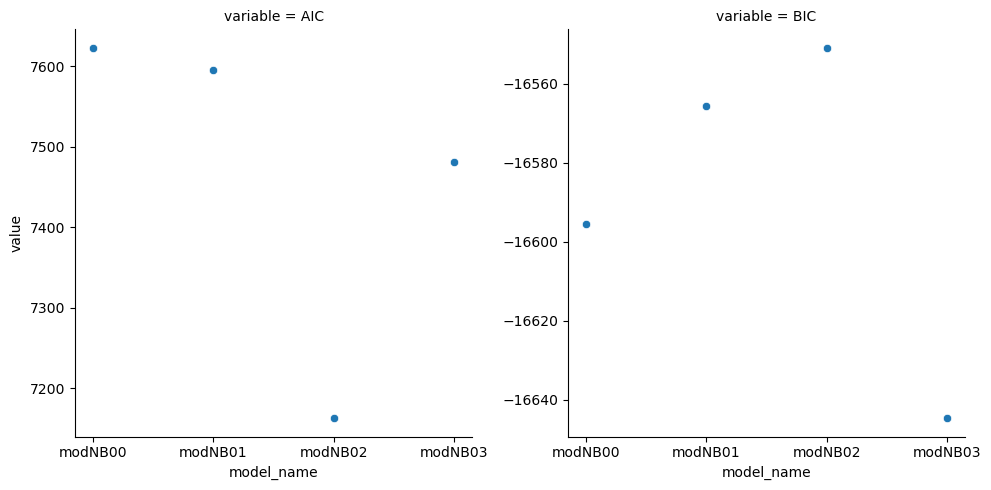

In [119]:
sns.relplot(data = modNB_results.melt(id_vars=['model_name']),
            x='model_name',
            y='value', 
            col='variable',
            col_wrap=2,
            facet_kws = {'sharey': False})

plt.show()

In [120]:
print(modNB02.summary())

                 Generalized Linear Model Regression Results                  
Dep. Variable:           final_events   No. Observations:                 2444
Model:                            GLM   Df Residuals:                     2295
Model Family:        NegativeBinomial   Df Model:                          148
Link Function:                    Log   Scale:                          1.0000
Method:                          IRLS   Log-Likelihood:                -3432.4
Date:                Thu, 27 Apr 2023   Deviance:                       1353.3
Time:                        07:52:58   Pearson chi2:                 1.08e+03
No. Iterations:                    24   Pseudo R-squ. (CS):             0.3464
Covariance Type:            nonrobust                                         
                                  coef    std err          z      P>|z|      [0.025      0.975]
-----------------------------------------------------------------------------------------------
Intercept         

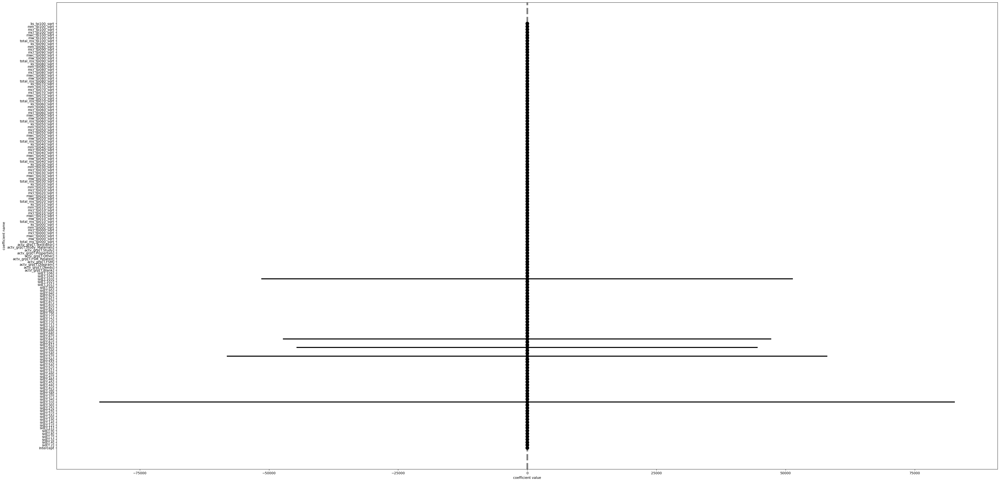

In [121]:
my_coefplot(modNB02)

### Negative Binomial with PCA

In [122]:
pc_dm00_y, pc_dm00_X = dmatrices('final_events ~ sid', data=pc_df_to_model, return_type='dataframe')
pc_dm01_y, pc_dm01_X = dmatrices('final_events ~ sid + actv_grp', data=pc_df_to_model, return_type='dataframe')
pc_dm02_y, pc_dm02_X = dmatrices('final_events ~ sid + actv_grp + ' + pc_features_str, data=pc_df_to_model, return_type='dataframe')
pc_dm03_y, pc_dm03_X = dmatrices('final_events ~ ' + pc_features_str, data=pc_df_to_model, return_type='dataframe')
pc_dm04_y, pc_dm04_X = dmatrices('final_events ~ (' + pc_features_str + ')**2', data=pc_df_to_model, return_type='dataframe')
pc_dm05_y, pc_dm05_X = dmatrices('final_events ~ actv_grp +' + pc_features_str, data=pc_df_to_model, return_type='dataframe')
pc_dm06_y, pc_dm06_X = dmatrices('final_events ~ actv_grp * (' + pc_features_str + ')', data=pc_df_to_model, return_type='dataframe')
pc_dm07_y, pc_dm07_X = dmatrices('final_events ~ actv_grp + (' + pc_features_str + ')**2', data=pc_df_to_model, return_type='dataframe')

In [123]:
pc_modNB00 = sm.GLM(pc_dm00_y, pc_dm00_X, family=sm.families.NegativeBinomial()).fit(loglike_method='nb2', bic_llf=True)
pc_modNB01 = sm.GLM(pc_dm01_y, pc_dm01_X, family=sm.families.NegativeBinomial()).fit(loglike_method='nb2', bic_llf=True)
pc_modNB02 = sm.GLM(pc_dm02_y, pc_dm02_X, family=sm.families.NegativeBinomial()).fit(loglike_method='nb2', bic_llf=True)
pc_modNB03 = sm.GLM(pc_dm03_y, pc_dm03_X, family=sm.families.NegativeBinomial()).fit(loglike_method='nb2', bic_llf=True)
pc_modNB04 = sm.GLM(pc_dm04_y, pc_dm04_X, family=sm.families.NegativeBinomial()).fit(loglike_method='nb2', bic_llf=True)
pc_modNB05 = sm.GLM(pc_dm05_y, pc_dm05_X, family=sm.families.NegativeBinomial()).fit(loglike_method='nb2', bic_llf=True)
pc_modNB06 = sm.GLM(pc_dm06_y, pc_dm06_X, family=sm.families.NegativeBinomial()).fit(loglike_method='nb2', bic_llf=True)
pc_modNB07 = sm.GLM(pc_dm07_y, pc_dm07_X, family=sm.families.NegativeBinomial()).fit(loglike_method='nb2', bic_llf=True)

In [124]:
pc_modNB_list = [pc_modNB00,pc_modNB01,pc_modNB02,pc_modNB03,pc_modNB04,pc_modNB05,pc_modNB06,pc_modNB07]

In [125]:
pc_modNB_results = pd.DataFrame({'model_name': ['pc_modNB00','pc_modNB01','pc_modNB02','pc_modNB03','pc_modNB04','pc_modNB05','pc_modNB06','pc_modNB07'],
                              'AIC': [mod.aic for mod in pc_modNB_list],
                              'BIC': [mod.bic for mod in pc_modNB_list]})

/Users/lisaover/opt/anaconda3/envs/cmpinf2120/lib/python3.8/site-packages/statsmodels/genmod/generalized_linear_model.py:1799: FutureWarning: The bic value is computed using the deviance formula. After 0.13 this will change to the log-likelihood based formula. This change has no impact on the relative rank of models compared using BIC. You can directly access the log-likelihood version using the `bic_llf` attribute. You can suppress this message by calling statsmodels.genmod.generalized_linear_model.SET_USE_BIC_LLF with True to get the LLF-based version now or False to retainthe deviance version.
  warnings.warn(


In [126]:
pc_modNB_results

,model_name,AIC,BIC
0,pc_modNB00,7622.925542,-16595.505299
1,pc_modNB01,7594.774720,-16565.642208
2,pc_modNB02,7203.795463,-16910.210334
3,pc_modNB03,7614.470712,-16911.433869
4,pc_modNB04,7561.898320,-16801.567304
5,pc_modNB05,7604.852347,-16863.038321
6,pc_modNB06,7690.765764,-16313.013598
7,pc_modNB07,7563.870430,-16741.581281


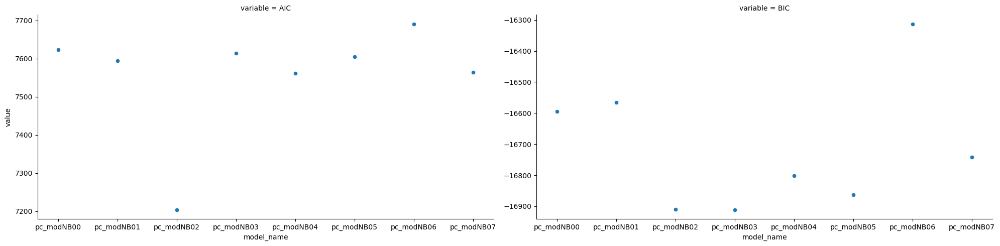

In [127]:
sns.relplot(data = pc_modNB_results.melt(id_vars=['model_name']),
            x='model_name',
            y='value', 
            col='variable',
            col_wrap=2,
            facet_kws = {'sharey': False},
            height=5, aspect=2)

plt.show()

In [128]:
print(pc_modNB02.summary())

                 Generalized Linear Model Regression Results                  
Dep. Variable:           final_events   No. Observations:                 2444
Model:                            GLM   Df Residuals:                     2364
Model Family:        NegativeBinomial   Df Model:                           79
Link Function:                    Log   Scale:                          1.0000
Method:                          IRLS   Log-Likelihood:                -3521.9
Date:                Thu, 27 Apr 2023   Deviance:                       1532.3
Time:                        07:53:00   Pearson chi2:                 1.20e+03
No. Iterations:                    24   Pseudo R-squ. (CS):             0.2967
Covariance Type:            nonrobust                                         
                                  coef    std err          z      P>|z|      [0.025      0.975]
-----------------------------------------------------------------------------------------------
Intercept         

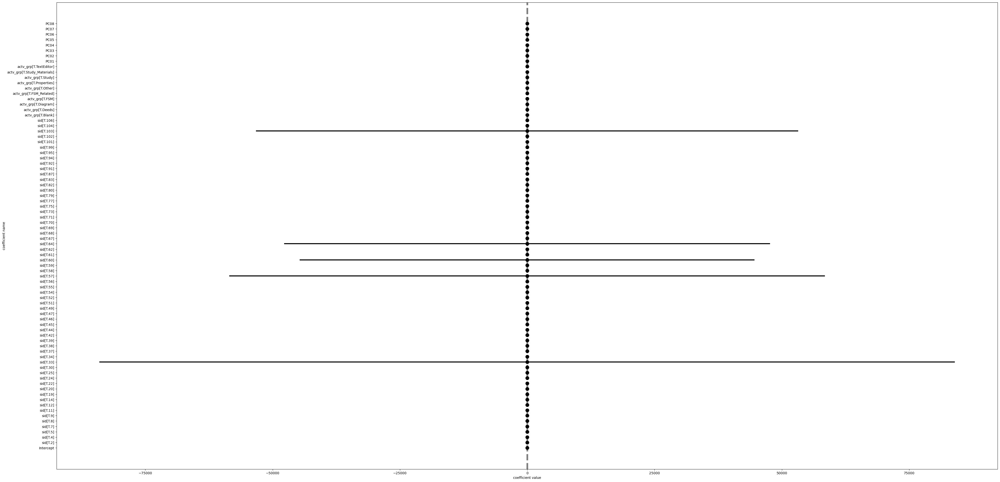

In [129]:
my_coefplot(pc_modNB02)

## Visualization Grid

In [130]:
best_model = smf.poisson( formula = 'final_events ~ sid + actv_grp + ' + pc_features_str, data = pc_df_to_model).fit(method='ncg')

Optimization terminated successfully.
         Current function value: 1.325239
         Iterations: 22
         Function evaluations: 24
         Gradient evaluations: 24
         Hessian evaluations: 22


In [131]:
print(best_model.summary())

                          Poisson Regression Results                          
Dep. Variable:           final_events   No. Observations:                 2444
Model:                        Poisson   Df Residuals:                     2364
Method:                           MLE   Df Model:                           79
Date:                Thu, 27 Apr 2023   Pseudo R-squ.:                  0.2280
Time:                        07:53:01   Log-Likelihood:                -3238.9
converged:                       True   LL-Null:                       -4195.6
Covariance Type:            nonrobust   LLR p-value:                     0.000
                                  coef    std err          z      P>|z|      [0.025      0.975]
-----------------------------------------------------------------------------------------------
Intercept                       0.8569      0.125      6.841      0.000       0.611       1.102
sid[T.2]                       -0.6452      0.171     -3.766      0.000      -0.

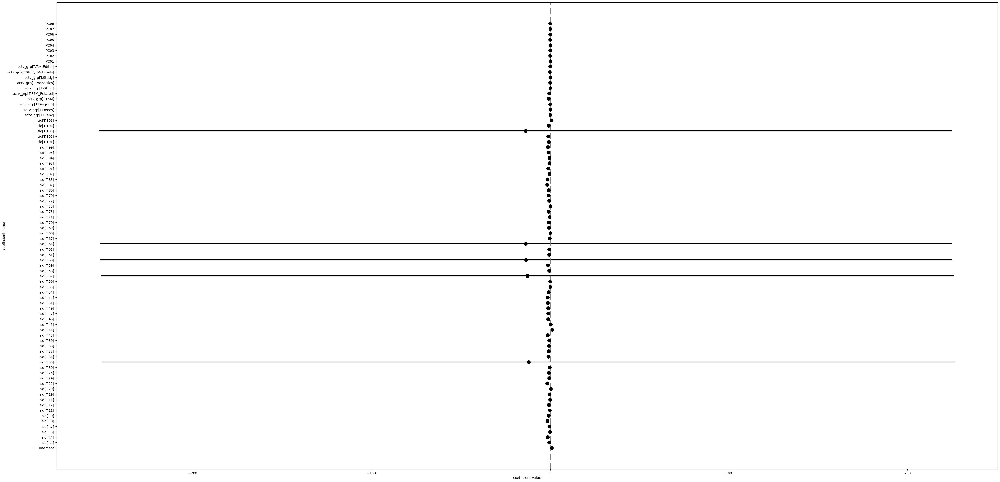

In [132]:
my_coefplot(best_model)

In [133]:
pc_df_to_model.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2444 entries, 0 to 2443
Data columns (total 82 columns):
 #   Column        Non-Null Count  Dtype  
---  ------        --------------  -----  
 0   sess          2444 non-null   object 
 1   sid           2444 non-null   object 
 2   actv_grp      2444 non-null   object 
 3   final_events  2444 non-null   float64
 4   final_trials  2444 non-null   float64
 5   PC01          2444 non-null   float64
 6   PC02          2444 non-null   float64
 7   PC03          2444 non-null   float64
 8   PC04          2444 non-null   float64
 9   PC05          2444 non-null   float64
 10  PC06          2444 non-null   float64
 11  PC07          2444 non-null   float64
 12  PC08          2444 non-null   float64
 13  PC09          2444 non-null   float64
 14  PC10          2444 non-null   float64
 15  PC11          2444 non-null   float64
 16  PC12          2444 non-null   float64
 17  PC13          2444 non-null   float64
 18  PC14          2444 non-null 

In [134]:
pc_df_to_model.head()

,sess,sid,actv_grp,final_events,final_trials,PC01,PC02,PC03,PC04,PC05,...,PC68,PC69,PC70,PC71,PC72,PC73,PC74,PC75,PC76,PC77
0,1,1,Aulaweb,2.0,2.0,-1.343494,0.614381,3.048655,-2.980032,-0.717602,...,0.021226,0.007764,-0.042438,0.007726,0.016882,-0.033860,-0.020212,-0.020811,0.002340,0.013947
1,1,1,Blank,2.0,2.0,2.264423,-0.252348,3.635242,-1.695365,-0.567017,...,-0.054488,0.016730,0.010136,-0.022828,-0.049764,-0.025509,-0.011965,-0.003058,0.010145,-0.003176
2,1,1,Deeds,2.0,2.0,2.407197,-0.285384,3.514516,-1.835526,-0.700168,...,-0.008969,-0.002833,-0.015106,0.000015,-0.020132,-0.009533,-0.014708,0.001780,0.028581,-0.000724
3,1,1,Diagram,2.0,2.0,1.800267,-0.177009,3.836746,-0.226538,0.360890,...,-0.052102,0.019233,-0.019455,-0.021534,-0.068026,-0.055084,0.009613,0.001835,-0.002256,-0.030537
4,1,1,Other,2.0,2.0,2.285621,-0.236315,3.690869,-1.931407,-0.768909,...,-0.031325,-0.003566,0.041341,-0.008955,-0.027152,-0.000594,-0.012622,0.027929,0.006442,-0.031819


In [135]:
pc_df_to_model.PC01.min()

-16.59044209268085

In [136]:
pc_df_to_model.PC01.max()

25.04659416706056

In [137]:
pc_df_to_model.sid.unique()

array([1, 2, 4, 5, 7, 9, 11, 12, 14, 19, 20, 22, 30, 34, 37, 38, 39, 42,
       44, 46, 47, 49, 51, 52, 54, 55, 56, 59, 62, 67, 68, 70, 71, 73, 79,
       80, 82, 87, 91, 92, 94, 101, 102, 104, 8, 24, 61, 83, 95, 99, 103,
       25, 45, 69, 75, 106, 33, 57, 58, 60, 64, 77], dtype=object)

In [138]:
input_grid_pc01 = pd.DataFrame([ (xa, xb, xc, xd, xe, xf, xg, xh, xi, xj) for xa in np.linspace(pc_df_to_model.PC01.min() - 0.02, pc_df_to_model.PC01.max() + 0.02, num=101)
                            for xb in [0.]
                            for xc in [0.]
                            for xd in [0.]
                            for xe in [0.]
                            for xf in [0.]
                            for xg in [0.]
                            for xh in [0.]
                            #for xi in pc_df_to_model.sid.unique()
                            for xi in [5, 14, 20, 44, 87, 94, 102, 106]
                            for xj in actv_subgrp_1],
                           columns = ['PC01','PC02','PC03','PC04','PC05','PC06','PC07','PC08','sid','actv_grp'])

In [139]:
input_grid_pc01.describe()

,PC01,PC02,PC03,PC04,PC05,PC06,PC07,PC08,sid
count,4848.000000,4848.0,4848.0,4848.0,4848.0,4848.0,4848.0,4848.0,4848.000000
mean,4.228076,0.0,0.0,0.0,0.0,0.0,0.0,0.0,59.000000
std,12.152093,0.0,0.0,0.0,0.0,0.0,0.0,0.0,39.932179
min,-16.610442,0.0,0.0,0.0,0.0,0.0,0.0,0.0,5.000000
25%,-6.191183,0.0,0.0,0.0,0.0,0.0,0.0,0.0,18.500000
50%,4.228076,0.0,0.0,0.0,0.0,0.0,0.0,0.0,65.500000
75%,14.647335,0.0,0.0,0.0,0.0,0.0,0.0,0.0,96.000000
max,25.066594,0.0,0.0,0.0,0.0,0.0,0.0,0.0,106.000000


In [140]:
input_grid_pc01.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 4848 entries, 0 to 4847
Data columns (total 10 columns):
 #   Column    Non-Null Count  Dtype  
---  ------    --------------  -----  
 0   PC01      4848 non-null   float64
 1   PC02      4848 non-null   float64
 2   PC03      4848 non-null   float64
 3   PC04      4848 non-null   float64
 4   PC05      4848 non-null   float64
 5   PC06      4848 non-null   float64
 6   PC07      4848 non-null   float64
 7   PC08      4848 non-null   float64
 8   sid       4848 non-null   int64  
 9   actv_grp  4848 non-null   object 
dtypes: float64(8), int64(1), object(1)
memory usage: 378.9+ KB


In [141]:
input_grid_pc01['pred_probability'] = best_model.predict(input_grid_pc01)

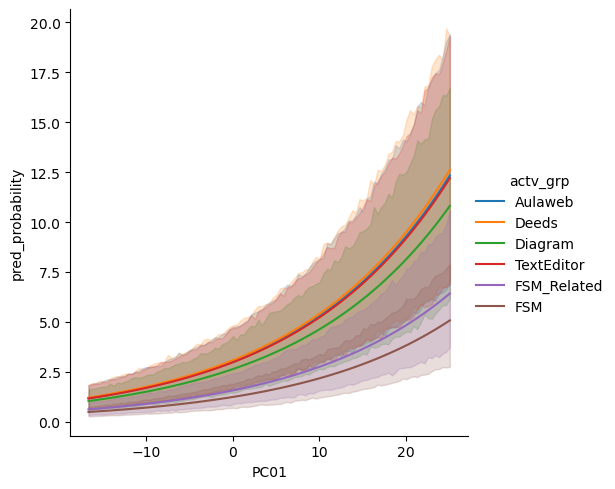

In [142]:
sns.relplot(data = input_grid_pc01, x='PC01', y='pred_probability', 
            hue='actv_grp', kind='line')

plt.show()

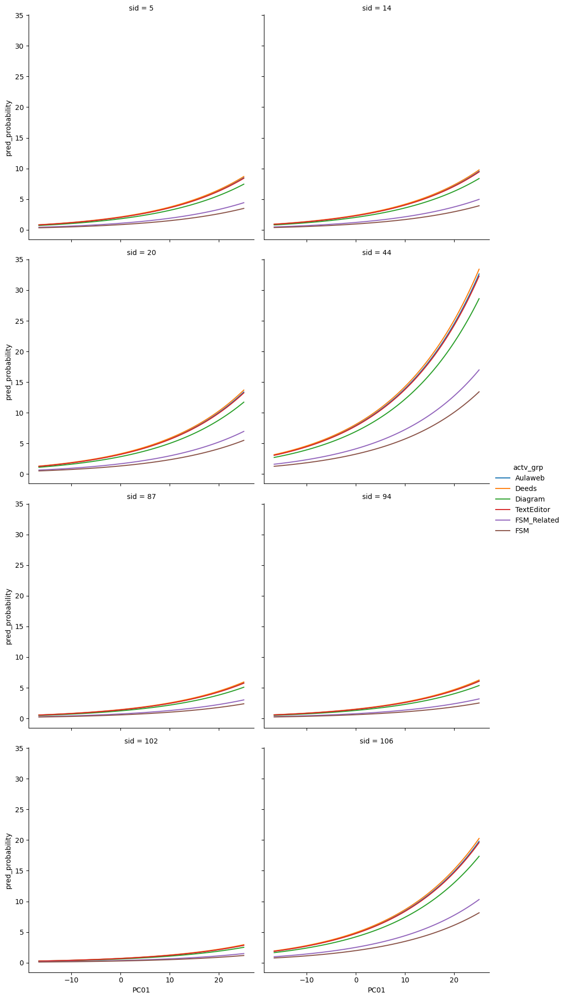

In [143]:
sns.relplot(data = input_grid_pc01, x='PC01', y='pred_probability', hue='actv_grp', 
            col='sid', col_wrap=2, kind='line')

plt.show()